In [14]:
import pandas as pd

# Load the dataset (replace 'your_file.csv' with the actual path)
df = pd.read_csv('Fashion Dataset.csv')

# Drop the unnamed index column if it exists
df = df.loc[:, ~df.columns.str.contains('^Unnamed')]

# Remove duplicates
df = df.drop_duplicates()

# Drop rows with missing values
df = df.dropna()

# Standardize text columns (convert to lowercase and strip spaces)
text_columns = ['name', 'colour', 'brand', 'description', 'p_attributes']
for col in text_columns:
    if col in df.columns:
        df[col] = df[col].str.lower().str.strip()

# Save the cleaned data
df.to_csv('cleaned_file.csv', index=False)

print("Dataset cleaned and saved as 'cleaned_file.csv'.")


Dataset cleaned and saved as 'cleaned_file.csv'.


Cleaning the Dataset

Integrating SQLLite

In [15]:
import pandas as pd
import sqlite3
from sklearn.model_selection import train_test_split

# Load the cleaned dataset
df = pd.read_csv('cleaned_file.csv')

# Split data into training and testing sets (80% train, 20% test)
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Save training and test sets
train_df.to_csv('train_data.csv', index=False)
test_df.to_csv('test_data.csv', index=False)

# Connect to SQLite database (creates a new one if not exists)
conn = sqlite3.connect('estyle.db')
cursor = conn.cursor()

# Create table if not exists
cursor.execute('''
    CREATE TABLE IF NOT EXISTS outfits (
        p_id INTEGER PRIMARY KEY,
        name TEXT,
        price REAL,
        colour TEXT,
        brand TEXT,
        img TEXT,
        ratingCount INTEGER,
        avg_rating REAL,
        description TEXT,
        p_attributes TEXT
    )
''')

# Insert training data into the table
train_df.to_sql('outfits', conn, if_exists='replace', index=False)

# Commit and close connection
conn.commit()
conn.close()

print("Data successfully split and training data imported into SQLite database 'estyle.db'.")


Data successfully split and training data imported into SQLite database 'estyle.db'.


In [16]:
import pandas as pd
import sqlite3
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
import numpy as np

# Load the cleaned dataset
df = pd.read_csv('cleaned_file.csv')

# Split data into training and testing sets (80% train, 20% test)
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Save training and test sets
train_df.to_csv('train_data.csv', index=False)
test_df.to_csv('test_data.csv', index=False)

# Connect to SQLite database (creates a new one if not exists)
conn = sqlite3.connect('estyle.db')
cursor = conn.cursor()

# Create table if not exists
cursor.execute('''
    CREATE TABLE IF NOT EXISTS outfits (
        p_id INTEGER PRIMARY KEY,
        name TEXT,
        price REAL,
        colour TEXT,
        brand TEXT,
        img TEXT,
        ratingCount INTEGER,
        avg_rating REAL,
        description TEXT,
        p_attributes TEXT
    )
''')

# Insert training data into the table
train_df.to_sql('outfits', conn, if_exists='replace', index=False)

# Commit and close connection
conn.commit()
conn.close()

print("Data successfully split and training data imported into SQLite database 'estyle.db'.")

# Prepare data for clustering
features = ['price', 'ratingCount', 'avg_rating']  # Select numerical features
train_df = train_df.dropna(subset=features)  # Drop rows with missing values
X = train_df[features].values  # Convert to NumPy array

# Apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)

# Assign cluster labels to outfits
train_df['cluster'] = kmeans.labels_

# Save clustered data
train_df.to_csv('clustered_train_data.csv', index=False)
print("Clustering completed and saved as 'clustered_train_data.csv'.")


KeyboardInterrupt: 

In [ ]:
import pandas as pd
import sqlite3
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np

# Load the cleaned dataset
df = pd.read_csv('cleaned_file.csv')

# Split data into training and testing sets (80% train, 20% test)
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Save training and test sets
train_df.to_csv('train_data.csv', index=False)
test_df.to_csv('test_data.csv', index=False)

# Prepare data for clustering
features = ['price', 'ratingCount', 'avg_rating']  # Select numerical features
train_df = train_df.dropna(subset=features)  # Drop rows with missing values
X = train_df[features].values  # Convert to NumPy array

# Apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)

# Assign cluster labels to outfits
train_df['cluster'] = kmeans.labels_

# Save clustered data
train_df.to_csv('clustered_train_data.csv', index=False)
print("Clustering completed and saved as 'clustered_train_data.csv'.")

# Evaluate clustering using Silhouette Score
silhouette_avg = silhouette_score(X, kmeans.labels_)
print(f"Silhouette Score: {silhouette_avg:.4f}")


Clustering completed and saved as 'clustered_train_data.csv'.
Silhouette Score: 0.5463


In [ ]:
import pandas as pd
import sqlite3
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import requests
from io import BytesIO

# Load the cleaned dataset
df = pd.read_csv('cleaned_file.csv')

# Split data into training and testing sets (80% train, 20% test)
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Save training and test sets
train_df.to_csv('train_data.csv', index=False)
test_df.to_csv('test_data.csv', index=False)

# Prepare data for clustering
features = ['price', 'ratingCount', 'avg_rating']  # Select numerical features
train_df = train_df.dropna(subset=features)  # Drop rows with missing values
X = train_df[features].values  # Convert to NumPy array

# Apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)

# Assign cluster labels to outfits
train_df['cluster'] = kmeans.labels_

# Save clustered data
train_df.to_csv('clustered_train_data.csv', index=False)
print("Clustering completed and saved as 'clustered_train_data.csv'.")

# Evaluate clustering using Silhouette Score
silhouette_avg = silhouette_score(X, kmeans.labels_)
print(f"Silhouette Score: {silhouette_avg:.4f}")

# Function to generate outfit combinations based on user's clothes and display images from URLs
def generate_combinations(user_color):
    user_clothes = test_df[test_df['colour'].str.lower() == user_color.lower()]
    
    if user_clothes.empty:
        print(f"No outfits found in user's clothes with color {user_color}.")
        return
    
    print(f"Outfit combinations for color: {user_color}")
    for _, item in user_clothes.iterrows():
        cluster_id = kmeans.predict([[item['price'], item['ratingCount'], item['avg_rating']]])[0]
        similar_items = train_df[train_df['cluster'] == cluster_id]
        
        print(f"\nUser Item: {item['name']} ({item['colour']})")
        print("Matching Outfit Suggestions:")
        print(similar_items[['name', 'colour', 'brand', 'price', 'image_path']].head(3).to_string(index=False))
        
        # Display images
        fig, axes = plt.subplots(1, 4, figsize=(15, 5))
        
        try:
            response = requests.get(item['img'])
            user_image = Image.open(BytesIO(response.content))
            axes[0].imshow(user_image)
            axes[0].set_title("User's Item")
            axes[0].axis("off")
        except:
            print("Could not load user image.")
        
        for idx, (_, outfit) in enumerate(similar_items.head(3).iterrows()):
            try:
                response = requests.get(outfit['image_path'])
                outfit_image = Image.open(BytesIO(response.content))
                axes[idx + 1].imshow(outfit_image)
                axes[idx + 1].set_title(f"Suggested {idx+1}")
                axes[idx + 1].axis("off")
            except:
                print(f"Could not load image for: {outfit['name']}")
        
        plt.show()

# Example usage
user_input_color = input("Enter a color: ")
generate_combinations(user_input_color)


Clustering completed and saved as 'clustered_train_data.csv'.
Silhouette Score: 0.5463
Outfit combinations for color: black

User Item: here&now women black slim fit mid-rise clean look stretchable jeans (black)
Matching Outfit Suggestions:


KeyError: "['image_path'] not in index"

Clustering completed and saved as 'clustered_train_data.csv'.
Silhouette Score: 0.5463
Outfit combinations for color: black

User Item: here&now women black slim fit mid-rise clean look stretchable jeans (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured pr

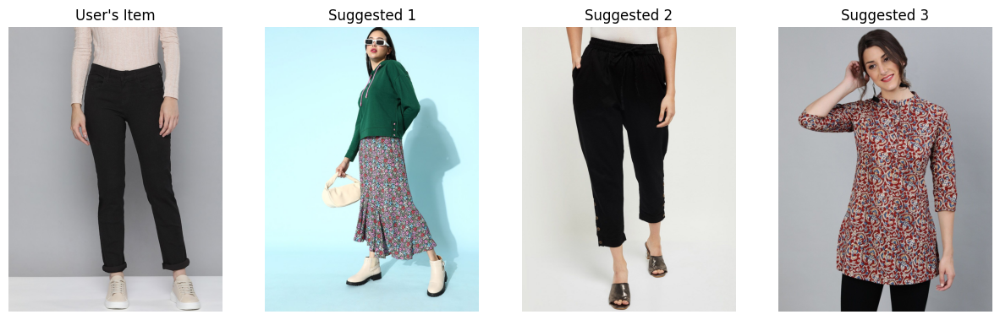


User Item: oxolloxo women black & red printed open front shrug (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-45

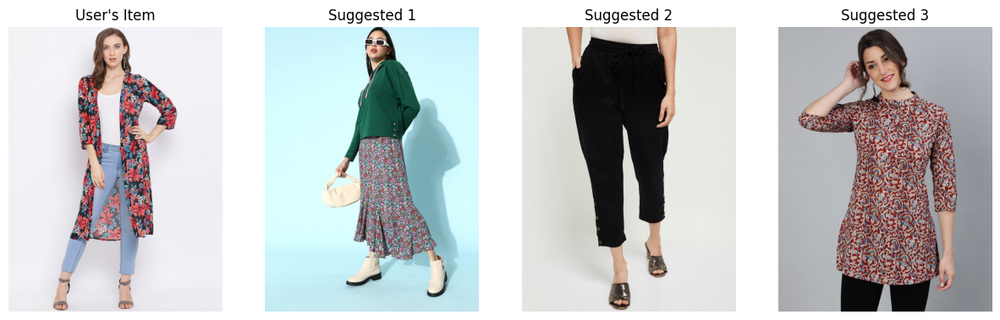


User Item: fablestreet women black straight fit trousers (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7

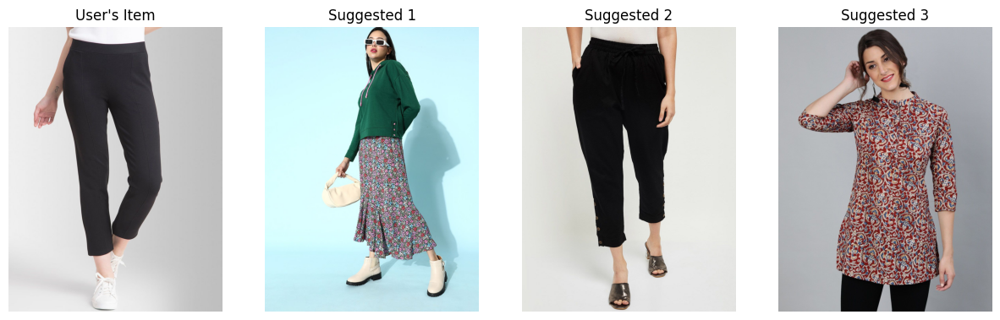


User Item: high star women black slim fit mid-rise clean look stretchable jeans (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22

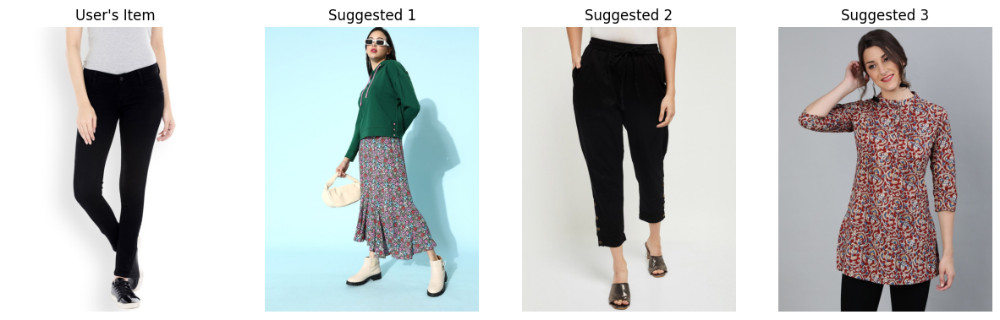


User Item: roadster women black solid pure cotton denim jacket (black)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
                          shavya white pure silk self-checked kasavu saree  white   shavya 3999.0           http://assets.myntassets.com/assets/images/12122978/2020/8/20/23ed32e7-b281-4ea8-9497-a67b9edd3cc81597904421205ShavyaGoldWhiteGoldTonedZariOnamFestiveKasavuSaree1.jpg
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted midi pencil skirt

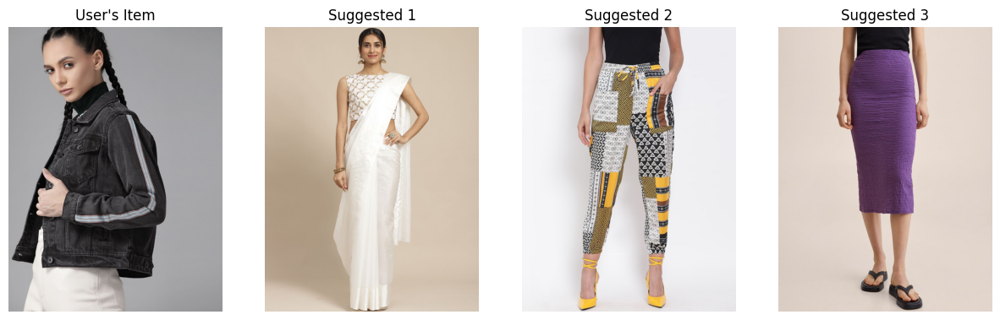


User Item: anayna women black & white ethnic motifs printed kantha work kurta (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/4

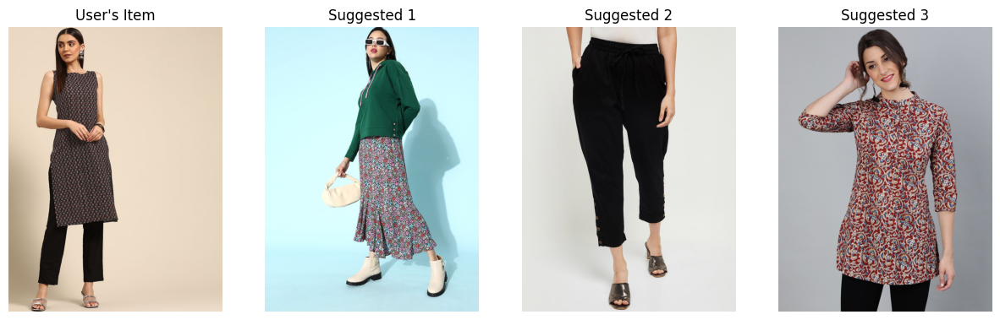


User Item: antheaa women black solid basic jumpsuit (black)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
                          shavya white pure silk self-checked kasavu saree  white   shavya 3999.0           http://assets.myntassets.com/assets/images/12122978/2020/8/20/23ed32e7-b281-4ea8-9497-a67b9edd3cc81597904421205ShavyaGoldWhiteGoldTonedZariOnamFestiveKasavuSaree1.jpg
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted midi pencil skirt purple    

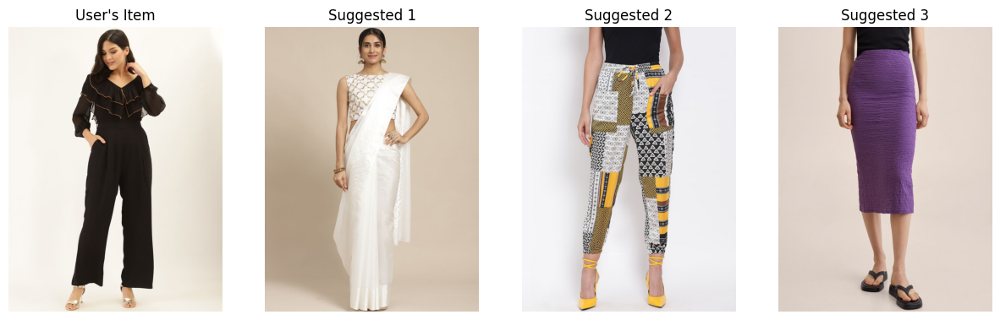


User Item: mango women black solid cropped shacket (black)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
                          shavya white pure silk self-checked kasavu saree  white   shavya 3999.0           http://assets.myntassets.com/assets/images/12122978/2020/8/20/23ed32e7-b281-4ea8-9497-a67b9edd3cc81597904421205ShavyaGoldWhiteGoldTonedZariOnamFestiveKasavuSaree1.jpg
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted midi pencil skirt purple    m

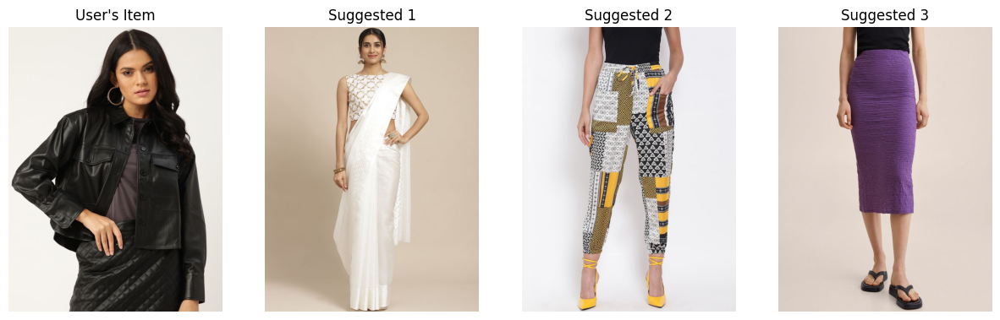


User Item: ahika women stylish black printed jumpsuit (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-b

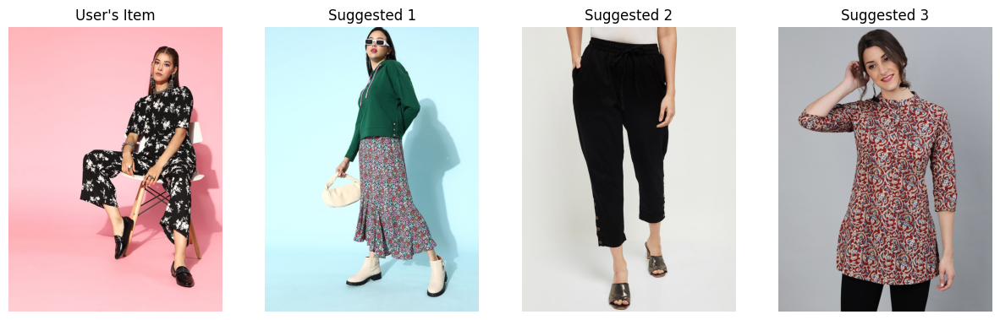


User Item: fablestreet women black printed top (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-b6c303a4

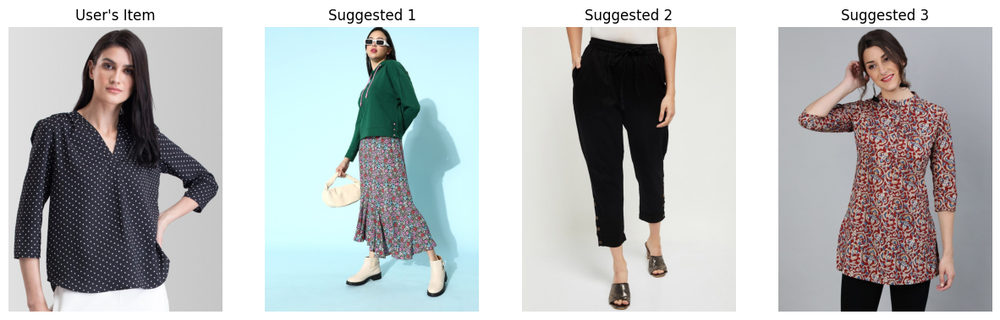


User Item: arise women black hooded sweatshirt (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-b6c303a4

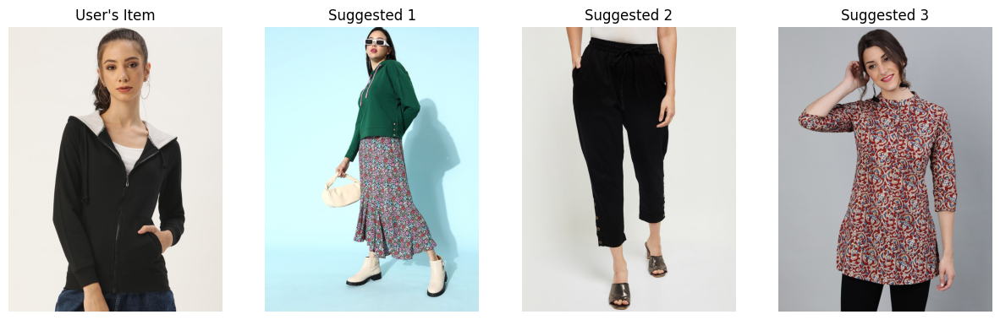


User Item: anvi be yourself women black & white printed midi flared skirt (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf

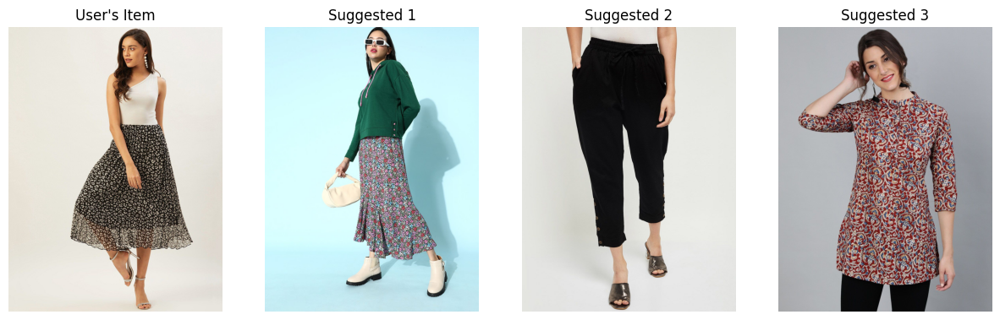


User Item: v&m women black self design basic jumpsuit (black)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
                          shavya white pure silk self-checked kasavu saree  white   shavya 3999.0           http://assets.myntassets.com/assets/images/12122978/2020/8/20/23ed32e7-b281-4ea8-9497-a67b9edd3cc81597904421205ShavyaGoldWhiteGoldTonedZariOnamFestiveKasavuSaree1.jpg
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted midi pencil skirt purple  

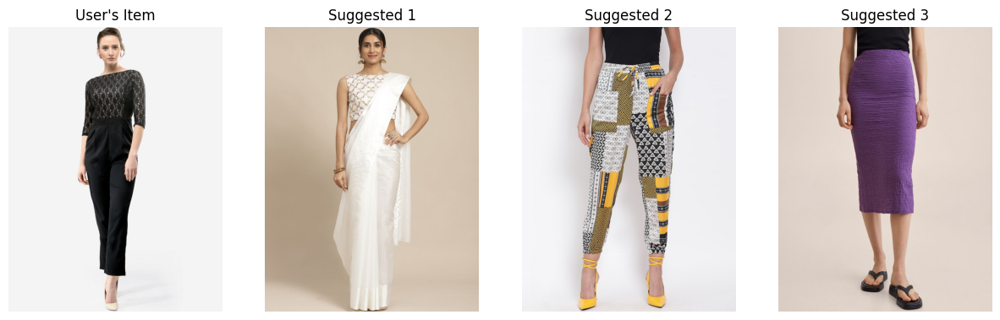


User Item: martini women black self design basic jumpsuit (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc

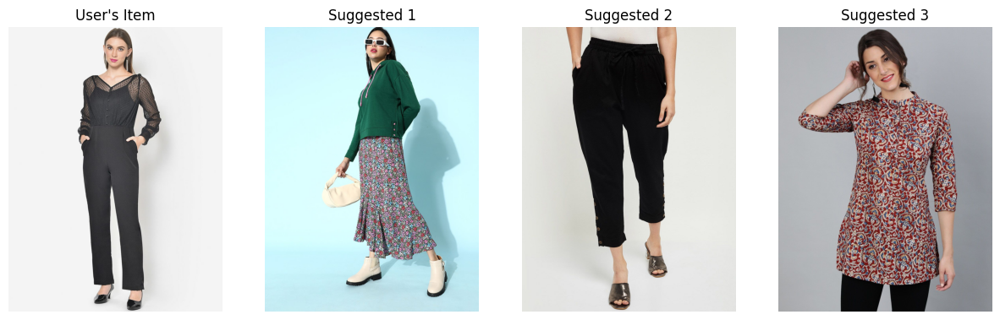


User Item: chkokko women black sporty jacket (black)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
                          shavya white pure silk self-checked kasavu saree  white   shavya 3999.0           http://assets.myntassets.com/assets/images/12122978/2020/8/20/23ed32e7-b281-4ea8-9497-a67b9edd3cc81597904421205ShavyaGoldWhiteGoldTonedZariOnamFestiveKasavuSaree1.jpg
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted midi pencil skirt purple    mango 2

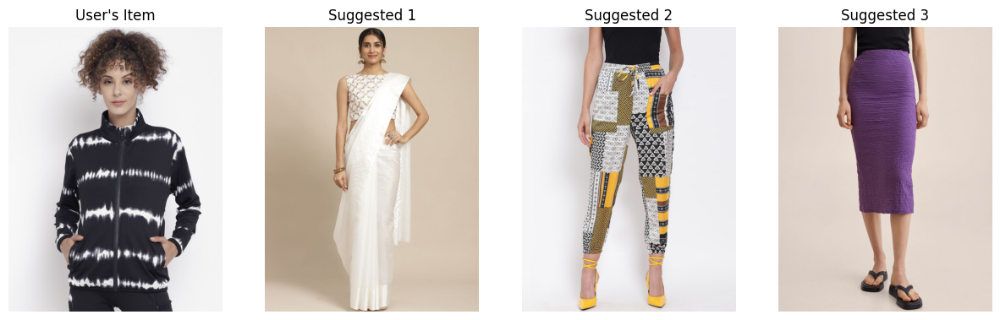


User Item: aasi - house of nayo women black & mustard yellow solid kurta with trousers & dupatta (black)
Matching Outfit Suggestions:
                                                     name colour     brand  price                                                                                                                                                                                img
ahika women green & mustard yellow printed straight kurta  green     ahika 1198.0                         http://assets.myntassets.com/assets/images/10808290/2019/10/30/3573b361-8560-4aad-bcf6-265ad635ef581572423341928-AHIKA-Women-Kurtas-2491572423340722-1.jpg
         kassually yellow & white floral print peplum top yellow kassually 1199.0                                                          http://assets.myntassets.com/assets/images/productimage/2020/9/22/d92dc791-64f1-47e0-ae7e-fa631ca15f0b1600728260009-1.jpg
            sassafras women white twill parallel trousers  white sassafras 1699.0 

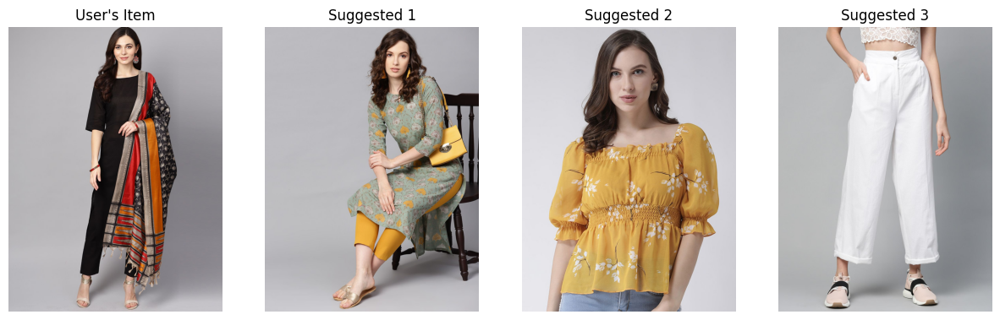


User Item: dressberry women black print detail sweatshirt (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc

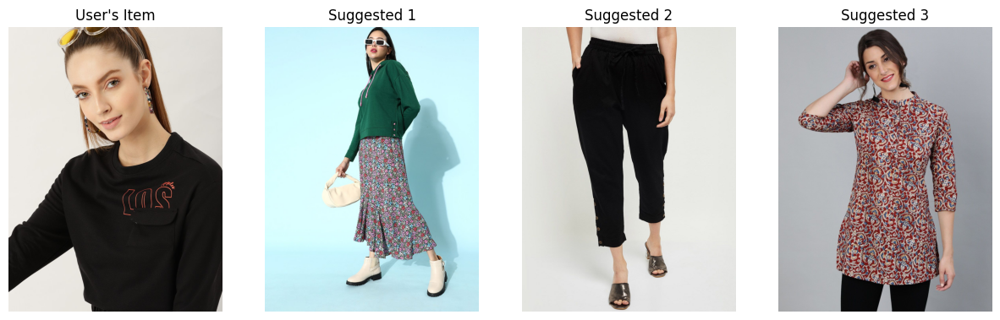


User Item: tokyo talkies women black solid slim-fit straight skirt (black)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
                          shavya white pure silk self-checked kasavu saree  white   shavya 3999.0           http://assets.myntassets.com/assets/images/12122978/2020/8/20/23ed32e7-b281-4ea8-9497-a67b9edd3cc81597904421205ShavyaGoldWhiteGoldTonedZariOnamFestiveKasavuSaree1.jpg
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted midi pencil s

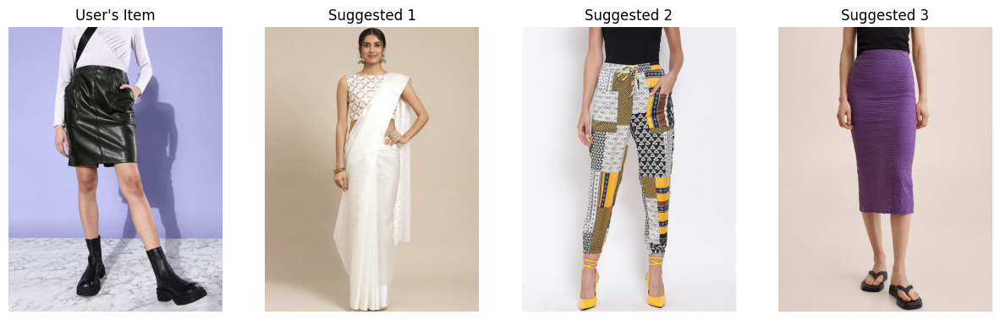


User Item: urbanic black semi sheer crop top (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-b6c303a45c

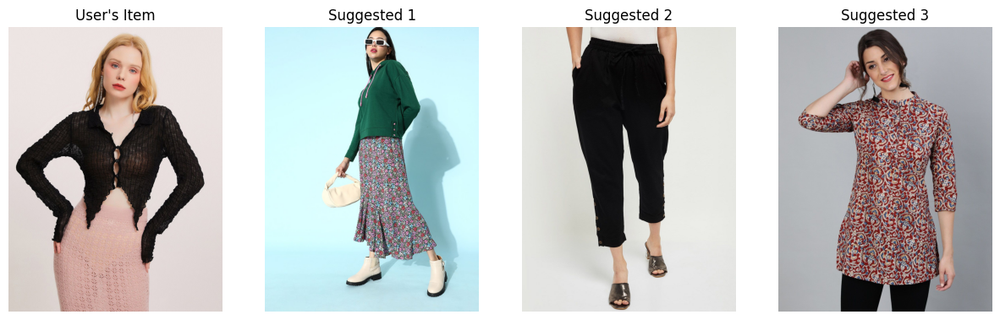


User Item: mabish by sonal jain women black solid open front sheer shrug (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf3

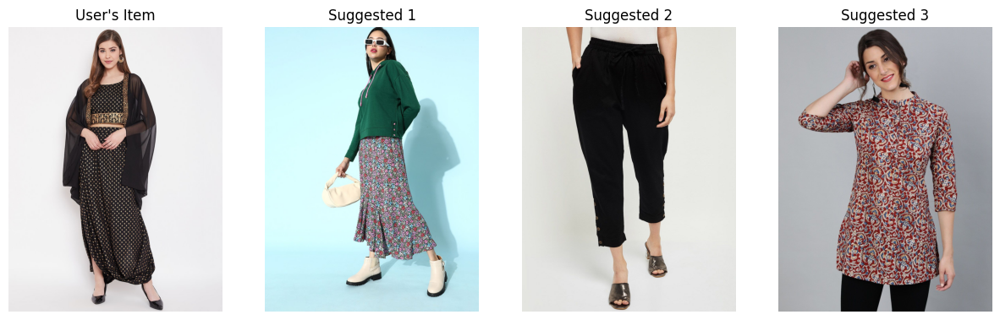


User Item: h&m women black self design stand collar faux shearling gilet (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf3

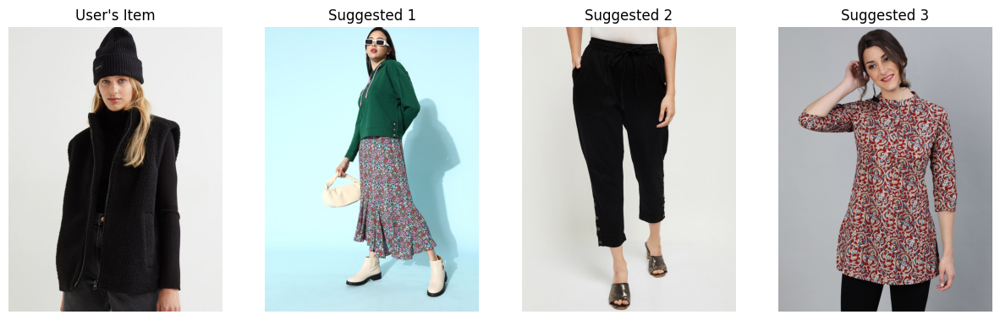


User Item: jockey women black bomber jacket (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-b6c303a45c7

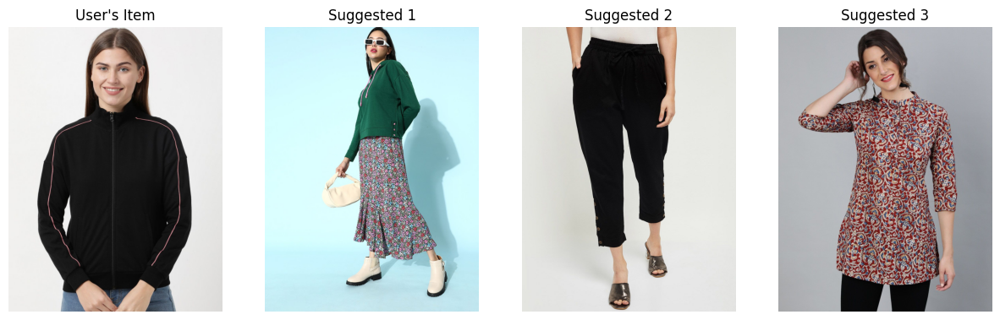


User Item: bhama couture black embroidered a-line pure cotton top (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f

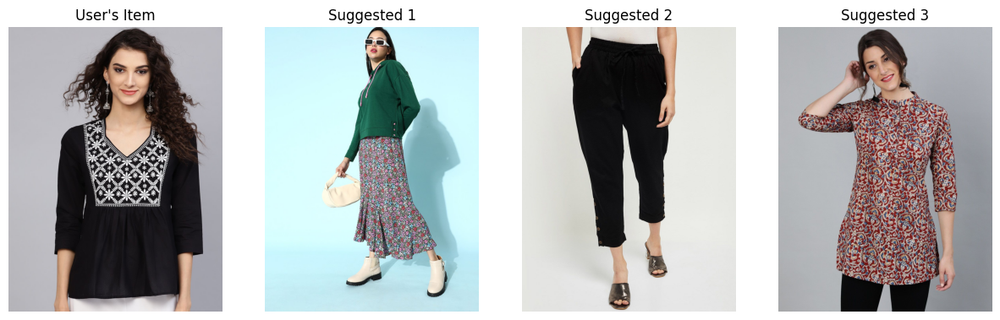


User Item: sassafras woman black high-rise relaxed fit jeans (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586

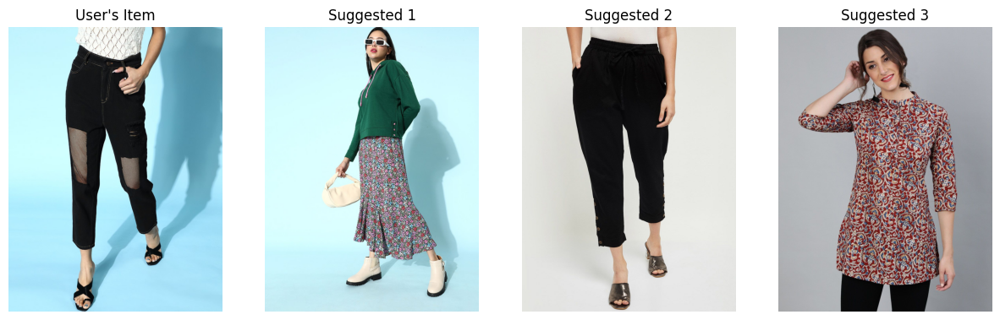


User Item: h&m women black ribbed unitard (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-b6c303a45c7d1

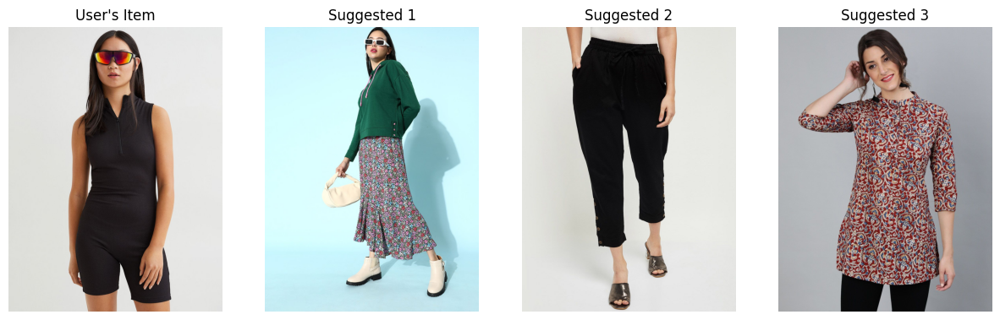


User Item: dolce crudo women black solid basic jumpsuit (black)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
                          shavya white pure silk self-checked kasavu saree  white   shavya 3999.0           http://assets.myntassets.com/assets/images/12122978/2020/8/20/23ed32e7-b281-4ea8-9497-a67b9edd3cc81597904421205ShavyaGoldWhiteGoldTonedZariOnamFestiveKasavuSaree1.jpg
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted midi pencil skirt purple

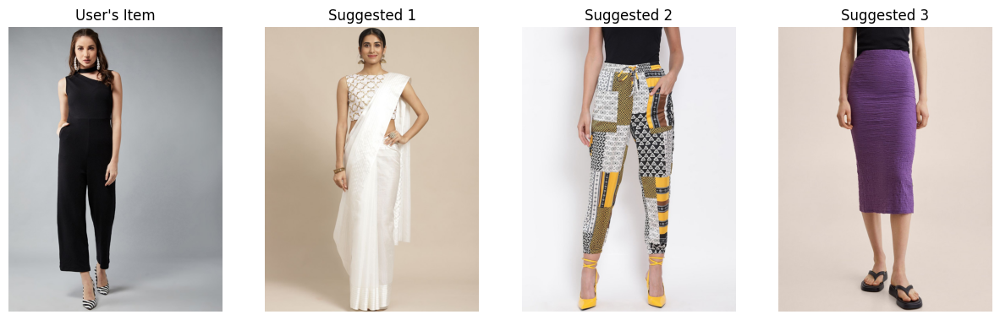


User Item: malhaar black & red floral printed pure cotton anarkali kurti (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf3

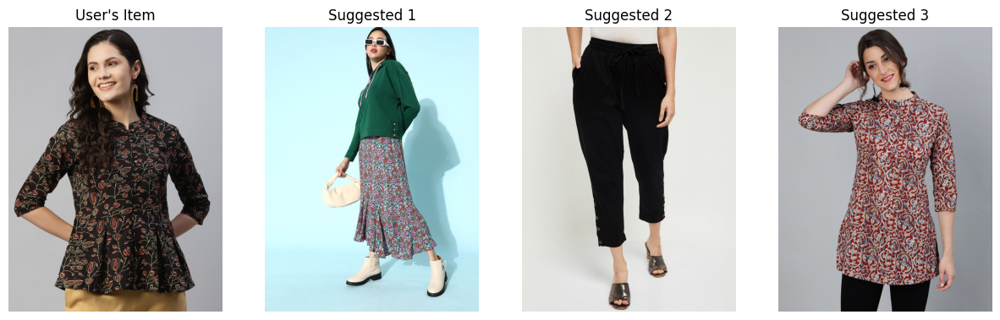


User Item: kassually women black skinny fit mid-rise clean look stretchable jeans (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/

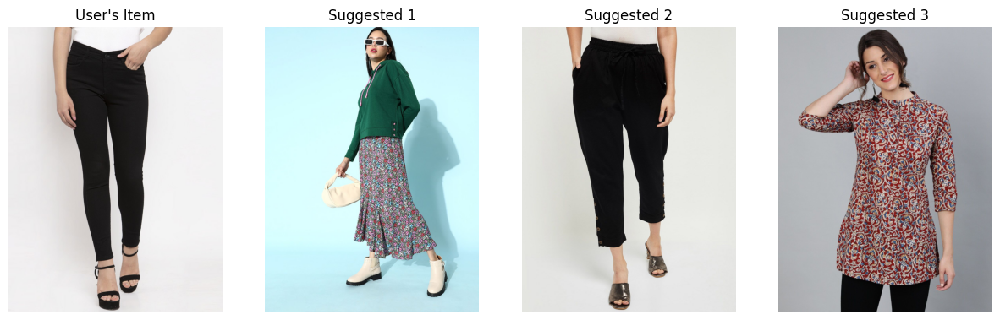


User Item: flying machine women black printed hooded cotton sweatshirt (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c

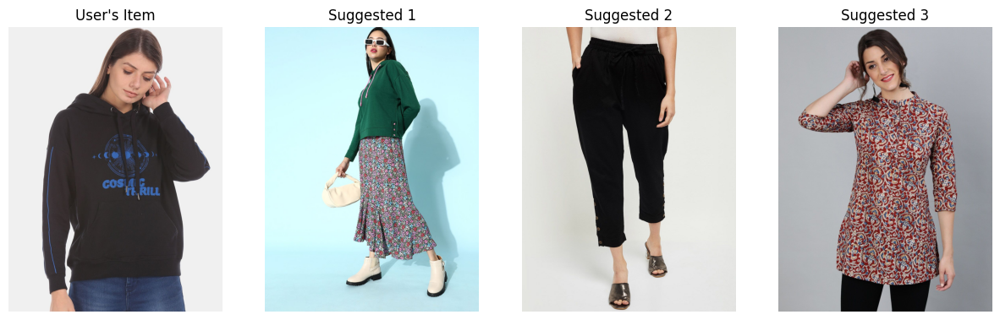


User Item: allen solly woman women black solid skinny fit high-rise stretchable jeans (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/202

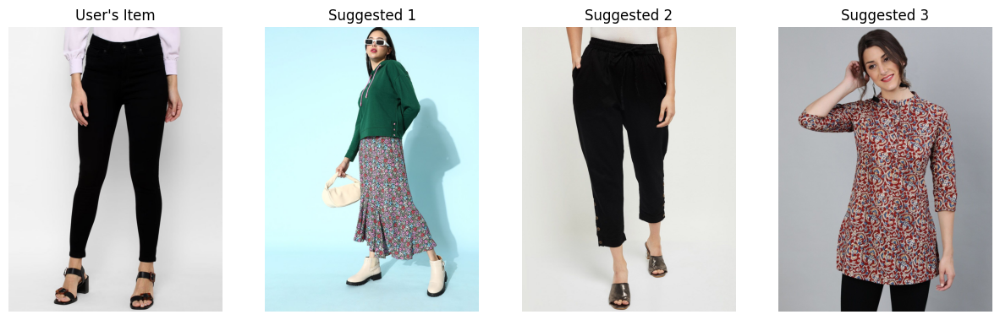


User Item: perfkt-u women black & mustard yellow colourblocked lightweight sporty jacket (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/

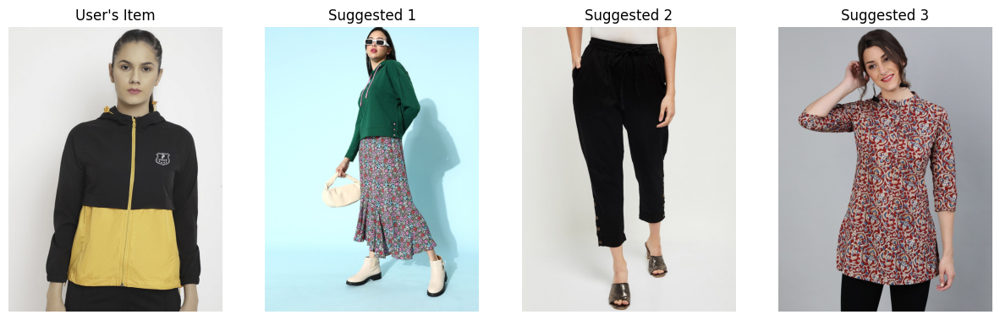


User Item: h&m women black checked sleeveless shirts (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-b6

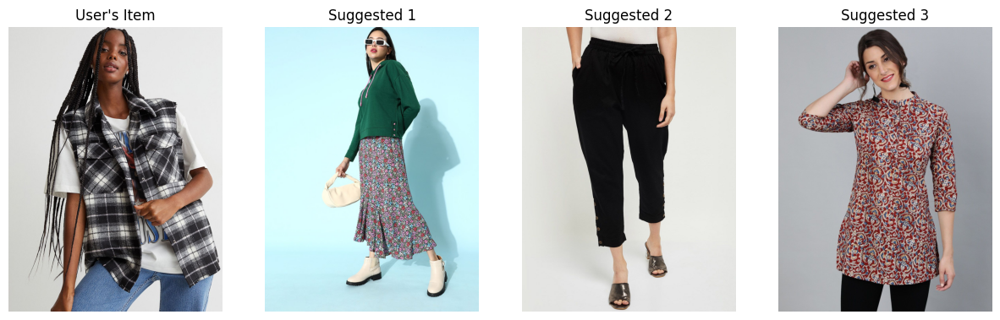


User Item: the roadster lifestyle co women black regular fit solid cargos with d-ring at hem (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170

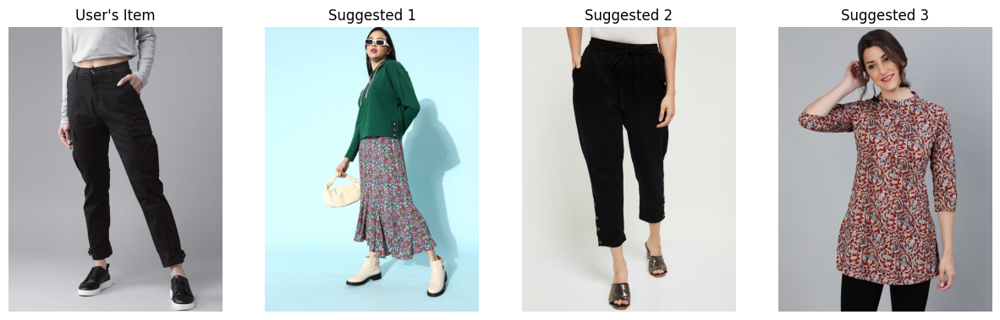


User Item: tokyo talkies black straight-fit straight mini skirt (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4

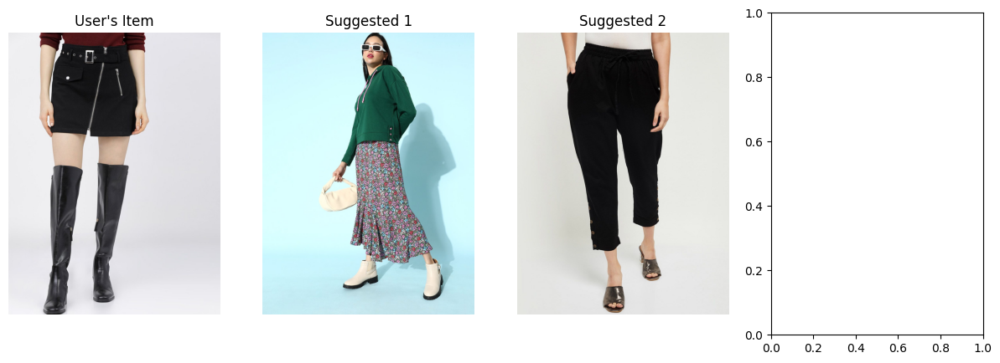


User Item: paris hamilton women black boyfriend fit high-rise stretchable jeans (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22

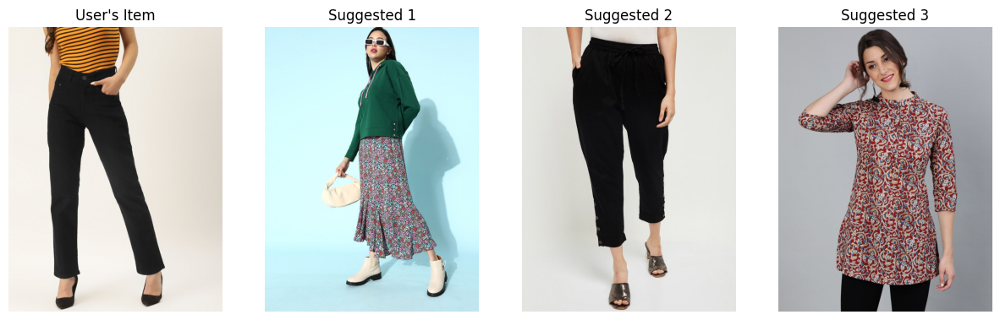


User Item: miaz lifestyle women black & pink pack of 2 solid wide leg woven palazzos (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021

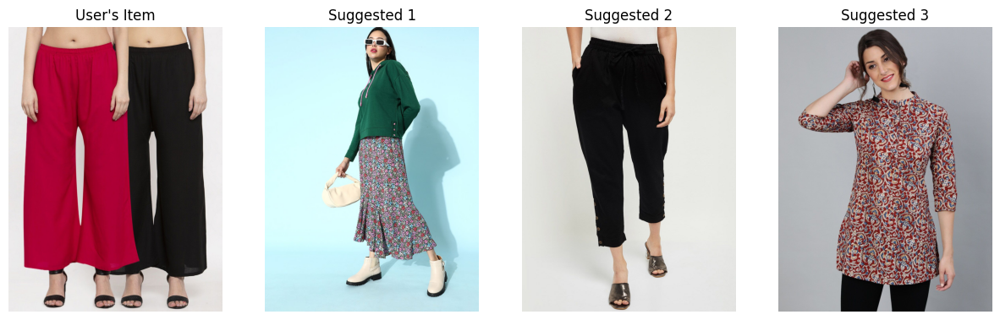


User Item: amydus women plus size black & white floral printed bomber jacket (black)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
                          shavya white pure silk self-checked kasavu saree  white   shavya 3999.0           http://assets.myntassets.com/assets/images/12122978/2020/8/20/23ed32e7-b281-4ea8-9497-a67b9edd3cc81597904421205ShavyaGoldWhiteGoldTonedZariOnamFestiveKasavuSaree1.jpg
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted mid

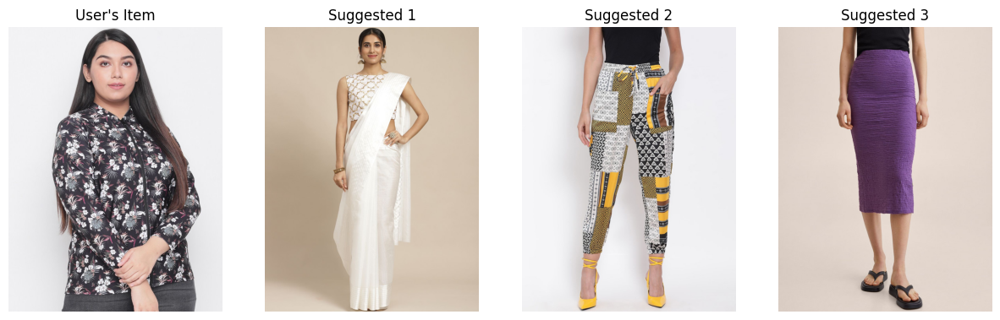


User Item: sassafras women black solid cotton mini skirt (black)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7

In [ ]:
import pandas as pd
import sqlite3
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import requests
from io import BytesIO

# Load the cleaned dataset
df = pd.read_csv('cleaned_file.csv')

# Split data into training and testing sets (80% train, 20% test)
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Save training and test sets
train_df.to_csv('train_data.csv', index=False)
test_df.to_csv('test_data.csv', index=False)

# Prepare data for clustering
features = ['price', 'ratingCount', 'avg_rating']  # Select numerical features
train_df = train_df.dropna(subset=features)  # Drop rows with missing values
X = train_df[features].values  # Convert to NumPy array

# Apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)

# Assign cluster labels to outfits
train_df['cluster'] = kmeans.labels_

# Save clustered data
train_df.to_csv('clustered_train_data.csv', index=False)
print("Clustering completed and saved as 'clustered_train_data.csv'.")

# Evaluate clustering using Silhouette Score
silhouette_avg = silhouette_score(X, kmeans.labels_)
print(f"Silhouette Score: {silhouette_avg:.4f}")

# Function to generate outfit combinations based on user's clothes and display images from URLs
def generate_combinations(user_color):
    user_clothes = test_df[test_df['colour'].str.lower() == user_color.lower()]
    
    if user_clothes.empty:
        print(f"No outfits found in user's clothes with color {user_color}.")
        return
    
    print(f"Outfit combinations for color: {user_color}")
    for _, item in user_clothes.iterrows():
        cluster_id = kmeans.predict([[item['price'], item['ratingCount'], item['avg_rating']]])[0]
        similar_items = train_df[train_df['cluster'] == cluster_id]
        
        print(f"\nUser Item: {item['name']} ({item['colour']})")
        print("Matching Outfit Suggestions:")
        print(similar_items[['name', 'colour', 'brand', 'price', 'img']].head(3).to_string(index=False))
        
        # Display images
        fig, axes = plt.subplots(1, 4, figsize=(15, 5))
        
        try:
            response = requests.get(item['img'])
            user_image = Image.open(BytesIO(response.content))
            axes[0].imshow(user_image)
            axes[0].set_title("User's Item")
            axes[0].axis("off")
        except:
            print("Could not load user image.")
        
        for idx, (_, outfit) in enumerate(similar_items.head(3).iterrows()):
            try:
                response = requests.get(outfit['img'])
                outfit_image = Image.open(BytesIO(response.content))
                axes[idx + 1].imshow(outfit_image)
                axes[idx + 1].set_title(f"Suggested {idx+1}")
                axes[idx + 1].axis("off")
            except:
                print(f"Could not load image for: {outfit['name']}")
        
        plt.show()

# Example usage
user_input_color = input("Enter a color: ")
generate_combinations(user_input_color)


Clustering completed and saved as 'clustered_train_data.csv'.
Silhouette Score: 0.5463
Outfit combinations for color: green

User Item: vbuyz green & red printed leheriya dupatta (green)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       

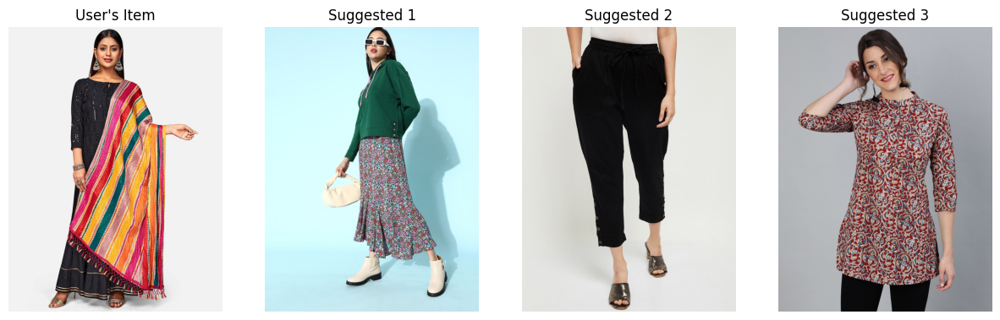


User Item: aurelia women green printed pleated trousers (green)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d

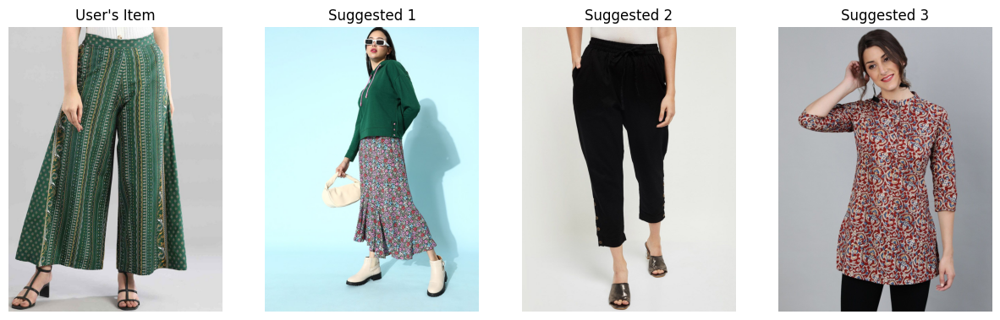


User Item: street 9 women green solid kurta with palazzos (green)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
                          shavya white pure silk self-checked kasavu saree  white   shavya 3999.0           http://assets.myntassets.com/assets/images/12122978/2020/8/20/23ed32e7-b281-4ea8-9497-a67b9edd3cc81597904421205ShavyaGoldWhiteGoldTonedZariOnamFestiveKasavuSaree1.jpg
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted midi pencil skirt purp

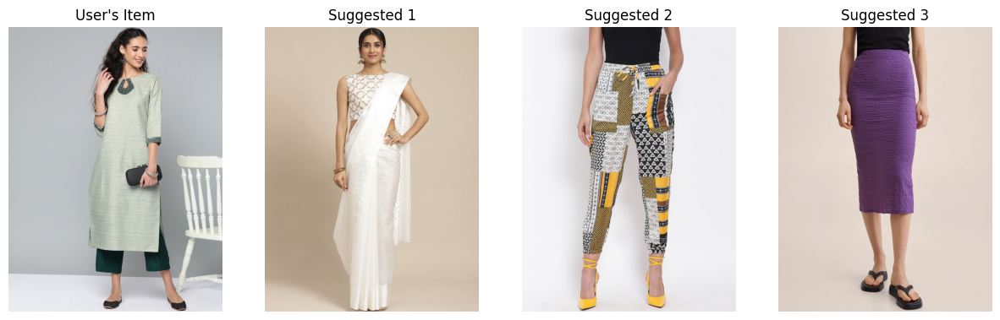


User Item: faballey women green & white printed basic jumpsuit (green)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-45

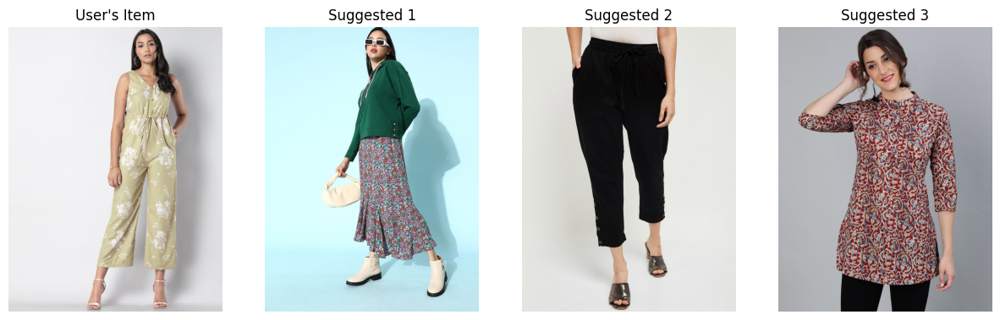


User Item: tokyo talkies women green solid casual-fit a-line skirt (green)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1

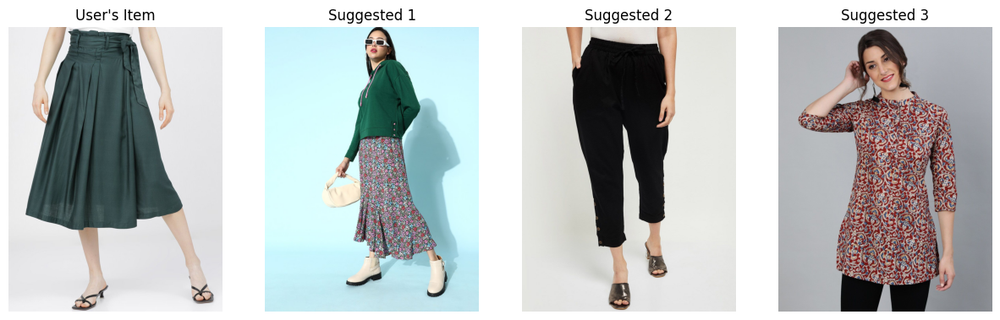

In [ ]:
import pandas as pd
import sqlite3
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import requests
from io import BytesIO

# Load the cleaned dataset
df = pd.read_csv('cleaned_file.csv')

# Split data into training and testing sets (80% train, 20% test)
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Save training and test sets
train_df.to_csv('train_data.csv', index=False)
test_df.to_csv('test_data.csv', index=False)

# Prepare data for clustering
features = ['price', 'ratingCount', 'avg_rating']  # Select numerical features
train_df = train_df.dropna(subset=features)  # Drop rows with missing values
X = train_df[features].values  # Convert to NumPy array

# Apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)

# Assign cluster labels to outfits
train_df['cluster'] = kmeans.labels_

# Save clustered data
train_df.to_csv('clustered_train_data.csv', index=False)
print("Clustering completed and saved as 'clustered_train_data.csv'.")

# Evaluate clustering using Silhouette Score
silhouette_avg = silhouette_score(X, kmeans.labels_)
print(f"Silhouette Score: {silhouette_avg:.4f}")

# Function to generate outfit combinations based on user's clothes and display images from URLs
def generate_combinations(user_color):
    user_clothes = test_df[test_df['colour'].str.lower() == user_color.lower()]
    
    if user_clothes.empty:
        print(f"No outfits found in user's clothes with color {user_color}.")
        return
    
    print(f"Outfit combinations for color: {user_color}")
    count = 0
    for _, item in user_clothes.iterrows():
        if count >= 5:
            break
        cluster_id = kmeans.predict([[item['price'], item['ratingCount'], item['avg_rating']]])[0]
        similar_items = train_df[train_df['cluster'] == cluster_id]
        
        print(f"\nUser Item: {item['name']} ({item['colour']})")
        print("Matching Outfit Suggestions:")
        print(similar_items[['name', 'colour', 'brand', 'price', 'img']].head(3).to_string(index=False))
        
        # Display images
        fig, axes = plt.subplots(1, 4, figsize=(15, 5))
        
        try:
            response = requests.get(item['img'])
            user_image = Image.open(BytesIO(response.content))
            axes[0].imshow(user_image)
            axes[0].set_title("User's Item")
            axes[0].axis("off")
        except:
            print("Could not load user image.")
        
        for idx, (_, outfit) in enumerate(similar_items.head(3).iterrows()):
            try:
                response = requests.get(outfit['img'])
                outfit_image = Image.open(BytesIO(response.content))
                axes[idx + 1].imshow(outfit_image)
                axes[idx + 1].set_title(f"Suggested {idx+1}")
                axes[idx + 1].axis("off")
            except:
                print(f"Could not load image for: {outfit['name']}")
        
        plt.show()
        count += 1

# Example usage
user_input_color = input("Enter a color: ")
generate_combinations(user_input_color)

Clustering completed and saved as 'clustered_train_data.csv'.
Silhouette Score: 0.5463
Outfit combinations for color: blue

User Item: la zoire women blue & white striped a-line top (blue)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon     

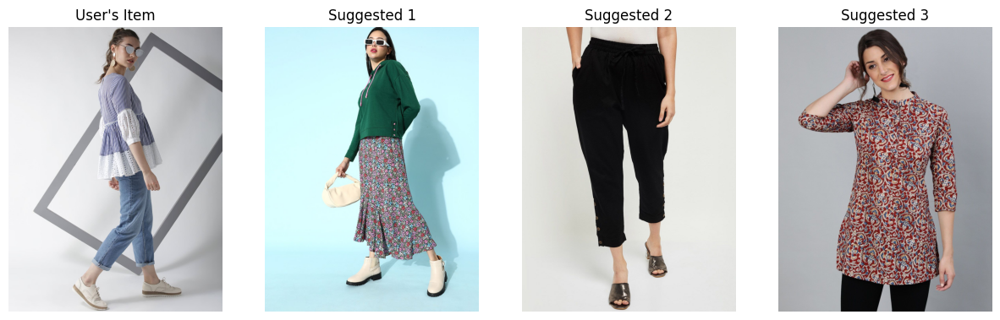


User Item: mango women blue flared high-rise light fade stretchable jeans (blue)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
                          shavya white pure silk self-checked kasavu saree  white   shavya 3999.0           http://assets.myntassets.com/assets/images/12122978/2020/8/20/23ed32e7-b281-4ea8-9497-a67b9edd3cc81597904421205ShavyaGoldWhiteGoldTonedZariOnamFestiveKasavuSaree1.jpg
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted midi pe

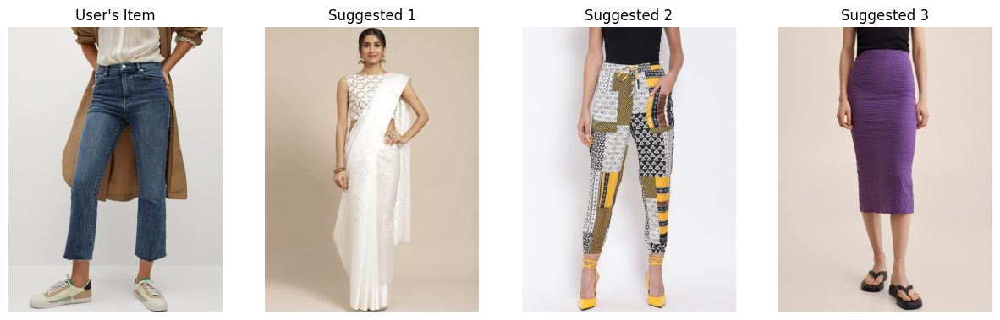


User Item: urbanic blue & white printed basic jumpsuit (blue)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-b

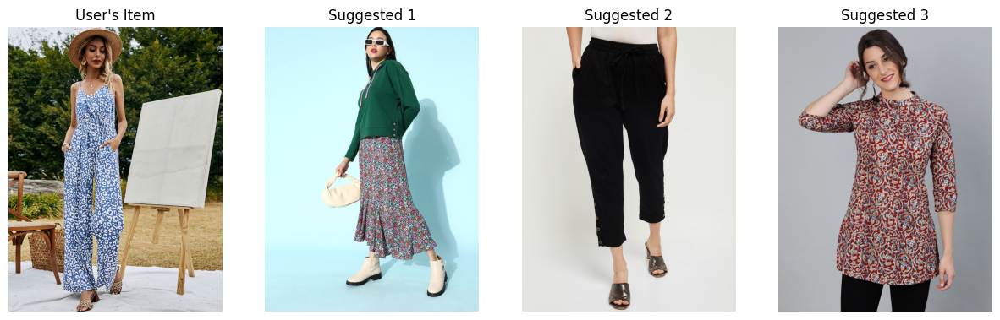


User Item: zink london women blue & white printed basic jumpsuit (blue)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
                          shavya white pure silk self-checked kasavu saree  white   shavya 3999.0           http://assets.myntassets.com/assets/images/12122978/2020/8/20/23ed32e7-b281-4ea8-9497-a67b9edd3cc81597904421205ShavyaGoldWhiteGoldTonedZariOnamFestiveKasavuSaree1.jpg
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted midi pencil skir

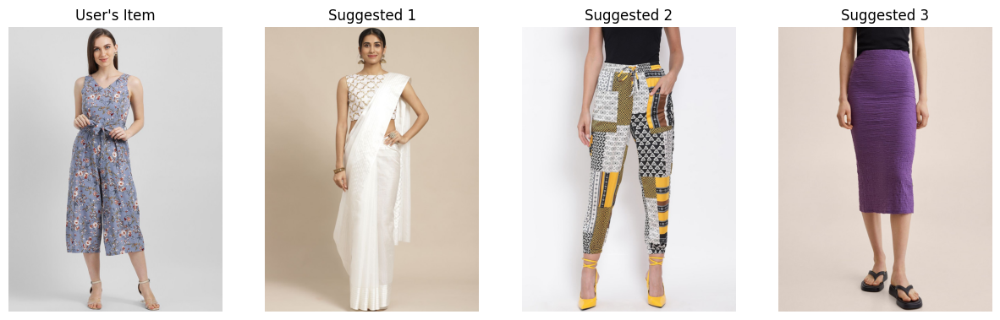


User Item: ed-a-mamma girls blue pure cotton denim a-line skirt (blue)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-45

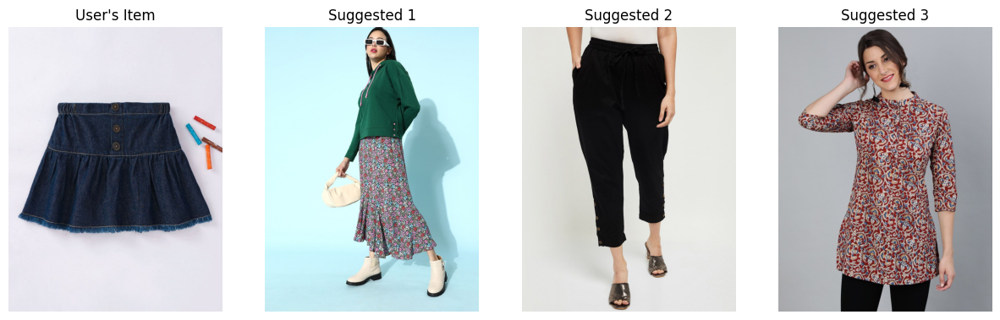

In [ ]:
import pandas as pd
import sqlite3
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import requests
from io import BytesIO

# Load the cleaned dataset
df = pd.read_csv('cleaned_file.csv')

# Split data into training and testing sets (80% train, 20% test)
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Save training and test sets
train_df.to_csv('train_data.csv', index=False)
test_df.to_csv('test_data.csv', index=False)

# Prepare data for clustering
features = ['price', 'ratingCount', 'avg_rating']  # Select numerical features
train_df = train_df.dropna(subset=features)  # Drop rows with missing values
X = train_df[features].values  # Convert to NumPy array

# Apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)

# Assign cluster labels to outfits
train_df['cluster'] = kmeans.labels_

# Save clustered data
train_df.to_csv('clustered_train_data.csv', index=False)
print("Clustering completed and saved as 'clustered_train_data.csv'.")

# Evaluate clustering using Silhouette Score
silhouette_avg = silhouette_score(X, kmeans.labels_)
print(f"Silhouette Score: {silhouette_avg:.4f}")

# Function to generate outfit combinations based on user's clothes and display images from URLs
def generate_combinations(user_color):
    user_clothes = test_df[test_df['colour'].str.lower() == user_color.lower()]
    
    if user_clothes.empty:
        print(f"No outfits found in user's clothes with color {user_color}.")
        return
    
    print(f"Outfit combinations for color: {user_color}")
    count = 0
    for _, item in user_clothes.iterrows():
        if count >= 5:
            break
        cluster_id = kmeans.predict([[item['price'], item['ratingCount'], item['avg_rating']]])[0]
        similar_items = train_df[train_df['cluster'] == cluster_id]
        
        # Exclude items too similar to the user's item
        similar_items = similar_items[similar_items['name'] != item['name']]
        
        print(f"\nUser Item: {item['name']} ({item['colour']})")
        print("Matching Outfit Suggestions:")
        print(similar_items[['name', 'colour', 'brand', 'price', 'img']].head(3).to_string(index=False))
        
        # Display images
        fig, axes = plt.subplots(1, 4, figsize=(15, 5))
        
        try:
            response = requests.get(item['img'])
            user_image = Image.open(BytesIO(response.content))
            axes[0].imshow(user_image)
            axes[0].set_title("User's Item")
            axes[0].axis("off")
        except:
            print("Could not load user image.")
        
        for idx, (_, outfit) in enumerate(similar_items.head(3).iterrows()):
            try:
                response = requests.get(outfit['img'])
                outfit_image = Image.open(BytesIO(response.content))
                axes[idx + 1].imshow(outfit_image)
                axes[idx + 1].set_title(f"Suggested {idx+1}")
                axes[idx + 1].axis("off")
            except:
                print(f"Could not load image for: {outfit['name']}")
        
        plt.show()
        count += 1

# Example usage
user_input_color = input("Enter a color: ")
generate_combinations(user_input_color)


Clustering completed and saved as 'clustered_train_data.csv'.
Silhouette Score: 0.5463
Outfit combinations for color: pink

User Item: sassafras women pink solid midi skirt (pink)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 12

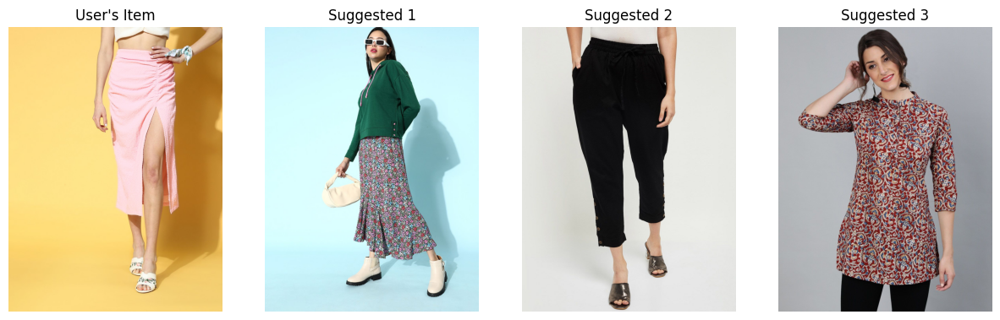


User Item: anubhutee women pink & white printed kurta with trousers & dupatta (pink)
Matching Outfit Suggestions:
                                                 name colour  brand  price                                                                                                                                                                              img
     shavya white pure silk self-checked kasavu saree  white shavya 3999.0           http://assets.myntassets.com/assets/images/12122978/2020/8/20/23ed32e7-b281-4ea8-9497-a67b9edd3cc81597904421205ShavyaGoldWhiteGoldTonedZariOnamFestiveKasavuSaree1.jpg
mango women purple textured knitted midi pencil skirt purple  mango 2790.0 http://assets.myntassets.com/assets/images/18259234/2022/5/26/d6d75426-4762-4a24-9f45-0add3c551d0e1653544520515MANGOWomenCream-ColouredCasualShirtShirtsMANGOMANMenJumpsuit1.jpg
         madame women mauve lightweight puffer jacket  mauve madame 3299.0                     http://assets.myntassets.com/asset

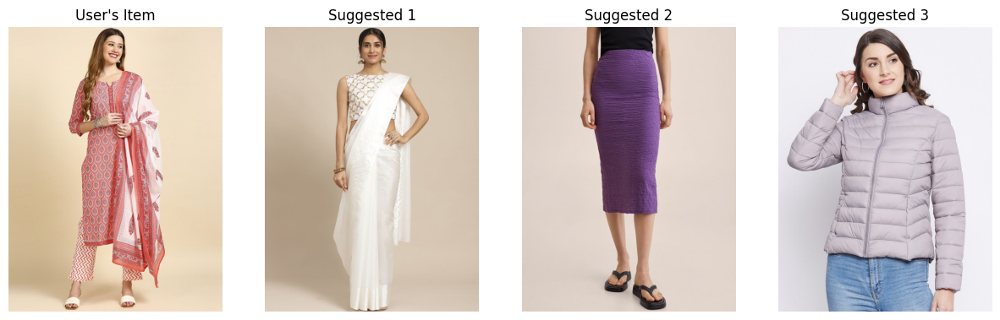


User Item: weavers villa women pink & off-white woven design shawl (pink)
Matching Outfit Suggestions:
                                                    name colour      brand  price                                                                                                                                                                 img
                 dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                                max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
cherokee women blue light fade mid rise stone wash jeans   blue   cherokee 2399.0                 http://assets.myntassets.com/assets/images/16021970/2021/11/

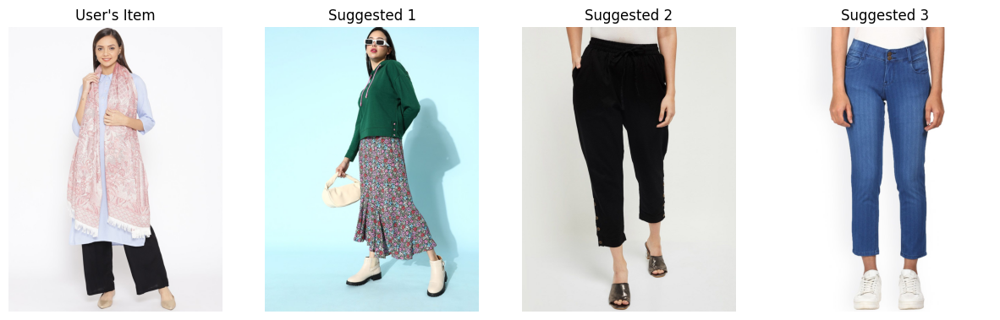


User Item: dressberry women pink solid pullover sweater (pink)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-

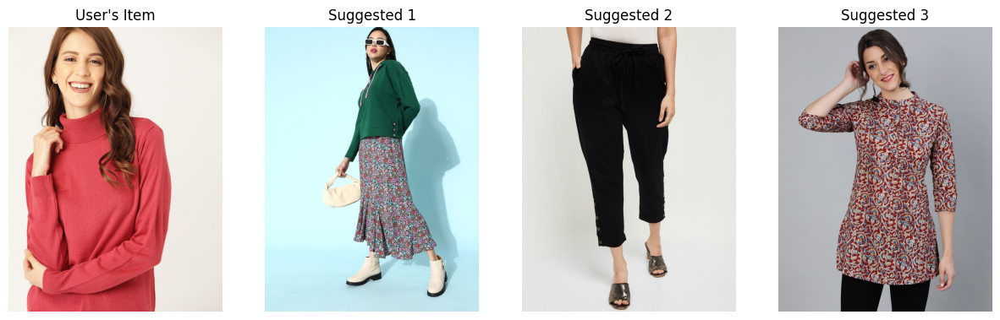


User Item: extra love by libas women plus size pink floral printed floral kurta (pink)
Matching Outfit Suggestions:
                                                    name colour      brand  price                                                                                                                                                                 img
                 dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                                max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
cherokee women blue light fade mid rise stone wash jeans   blue   cherokee 2399.0                 http://assets.myntassets.com/assets/images/1602

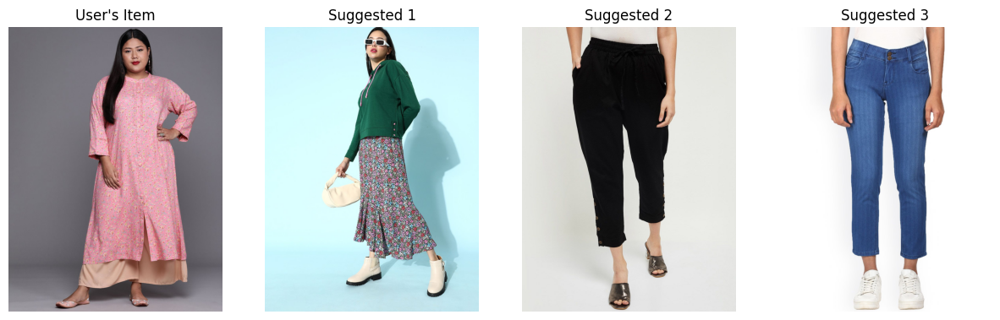

In [ ]:
import pandas as pd
import sqlite3
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import requests
from io import BytesIO

# Load the cleaned dataset
df = pd.read_csv('cleaned_file.csv')

# Split data into training and testing sets (80% train, 20% test)
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Save training and test sets
train_df.to_csv('train_data.csv', index=False)
test_df.to_csv('test_data.csv', index=False)

# Prepare data for clustering
features = ['price', 'ratingCount', 'avg_rating']  # Select numerical features
train_df = train_df.dropna(subset=features)  # Drop rows with missing values
X = train_df[features].values  # Convert to NumPy array

# Apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)

# Assign cluster labels to outfits
train_df['cluster'] = kmeans.labels_

# Save clustered data
train_df.to_csv('clustered_train_data.csv', index=False)
print("Clustering completed and saved as 'clustered_train_data.csv'.")

# Evaluate clustering using Silhouette Score
silhouette_avg = silhouette_score(X, kmeans.labels_)
print(f"Silhouette Score: {silhouette_avg:.4f}")

# Function to classify clothing items based on their names
def classify_clothing(name):
    name = name.lower()
    if any(word in name for word in ['shirt', 't-shirt', 'top', 'blouse']):
        return 'top'
    elif any(word in name for word in ['jeans', 'trousers', 'pants', 'joggers']):
        return 'bottom'
    elif any(word in name for word in ['skirt', 'shorts']):
        return 'skirt/shorts'
    elif any(word in name for word in ['dress', 'gown', 'jumpsuit']):
        return 'one-piece'
    elif any(word in name for word in ['jacket', 'coat', 'blazer']):
        return 'outerwear'
    elif any(word in name for word in ['sweater', 'hoodie', 'sweatshirt']):
        return 'warm-wear'
    else:
        return 'other'

# Apply classification to datasets
test_df['category'] = test_df['name'].apply(classify_clothing)
train_df['category'] = train_df['name'].apply(classify_clothing)

# Function to generate outfit combinations based on user's clothes and display images from URLs
def generate_combinations(user_color):
    user_clothes = test_df[test_df['colour'].str.lower() == user_color.lower()]
    
    if user_clothes.empty:
        print(f"No outfits found in user's clothes with color {user_color}.")
        return
    
    print(f"Outfit combinations for color: {user_color}")
    count = 0
    for _, item in user_clothes.iterrows():
        if count >= 5:
            break
        cluster_id = kmeans.predict([[item['price'], item['ratingCount'], item['avg_rating']]])[0]
        similar_items = train_df[train_df['cluster'] == cluster_id]
        
        # Exclude items that are too similar to the user's item
        similar_items = similar_items[similar_items['name'] != item['name']]
        
        # Ensure the suggested items are not of the same category
        similar_items = similar_items[similar_items['category'] != item['category']]
        
        print(f"\nUser Item: {item['name']} ({item['colour']})")
        print("Matching Outfit Suggestions:")
        print(similar_items[['name', 'colour', 'brand', 'price', 'img']].head(3).to_string(index=False))
        
        # Display images
        fig, axes = plt.subplots(1, 4, figsize=(15, 5))
        
        try:
            response = requests.get(item['img'])
            user_image = Image.open(BytesIO(response.content))
            axes[0].imshow(user_image)
            axes[0].set_title("User's Item")
            axes[0].axis("off")
        except:
            print("Could not load user image.")
        
        for idx, (_, outfit) in enumerate(similar_items.head(3).iterrows()):
            try:
                response = requests.get(outfit['img'])
                outfit_image = Image.open(BytesIO(response.content))
                axes[idx + 1].imshow(outfit_image)
                axes[idx + 1].set_title(f"Suggested {idx+1}")
                axes[idx + 1].axis("off")
            except:
                print(f"Could not load image for: {outfit['name']}")
        
        plt.show()
        count += 1

# Example usage
user_input_color = input("Enter a color: ")
generate_combinations(user_input_color)


Clustering completed and saved as 'clustered_train_data.csv'.
Silhouette Score: 0.5458
Outfit combinations for color: green

User Item: vbuyz green & red printed leheriya dupatta (green)
Matching Outfit Suggestions:
                                                    name colour      brand  price                                                                                                                                                                 img
                 dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                                max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
cherokee women blue light fade mid rise stone 

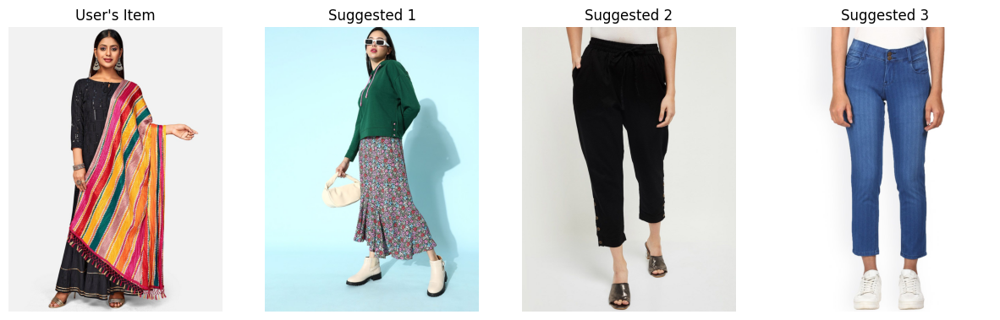


User Item: aurelia women green printed pleated trousers (green)
Matching Outfit Suggestions:
                                                                       name colour      brand  price                                                                                                                                                                                img
                                    dressberry women green solid sweatshirt  green dressberry 1799.0                http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                         nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                                         http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-b6c303a45c7d1619104363004NayoWomenMaroonPrinted1.jpg
anouk beige & red antiviral finish ethnic motifs anti-viral pure c

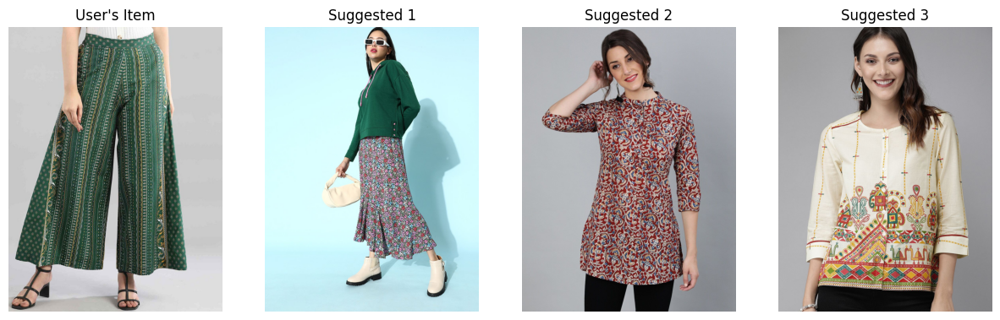


User Item: street 9 women green solid kurta with palazzos (green)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted midi pencil skirt purple    mango 2790.0 http://assets.myntassets.com/assets/images/18259234/2022/5/26/d6d75426-4762-4a24-9f45-0add3c551d0e1653544520515MANGOWomenCream-ColouredCasualShirtShirtsMANGOMANMenJumpsuit1.jpg
                              madame women mauve lightweight puffer jacket  mau

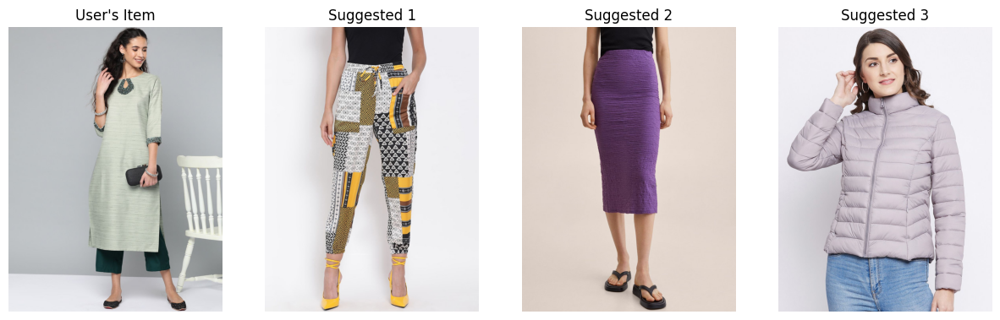


User Item: faballey women green & white printed basic jumpsuit (green)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-45

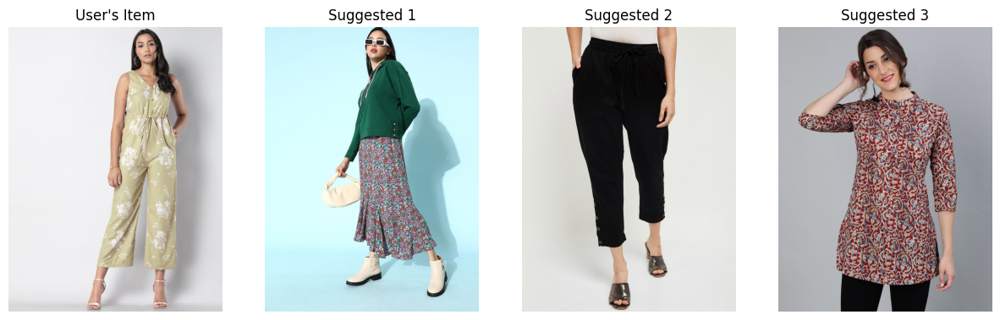


User Item: tokyo talkies women green solid casual-fit a-line skirt (green)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1

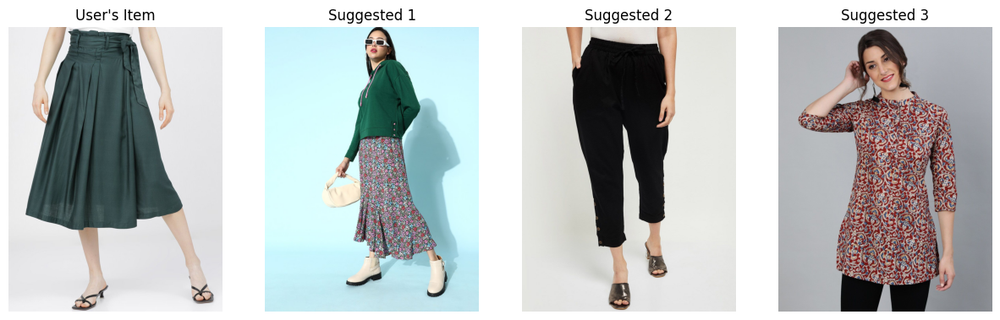

In [ ]:
import pandas as pd
import sqlite3
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import requests
from io import BytesIO
from sklearn.preprocessing import LabelEncoder

# Load the cleaned dataset
df = pd.read_csv('cleaned_file.csv')

# Encode categorical features
df['colour_encoded'] = LabelEncoder().fit_transform(df['colour'].astype(str))
df['category'] = df['name'].apply(lambda x: classify_clothing(x))
df['category_encoded'] = LabelEncoder().fit_transform(df['category'].astype(str))

# Split data into training and testing sets (80% train, 20% test)
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Save training and test sets
train_df.to_csv('train_data.csv', index=False)
test_df.to_csv('test_data.csv', index=False)

# Prepare data for clustering
features = ['price', 'ratingCount', 'avg_rating', 'colour_encoded', 'category_encoded']
train_df = train_df.dropna(subset=features)  # Drop rows with missing values
X = train_df[features].values  # Convert to NumPy array

# Apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)

# Assign cluster labels to outfits
train_df['cluster'] = kmeans.labels_

# Save clustered data
train_df.to_csv('clustered_train_data.csv', index=False)
print("Clustering completed and saved as 'clustered_train_data.csv'.")

# Evaluate clustering using Silhouette Score
silhouette_avg = silhouette_score(X, kmeans.labels_)
print(f"Silhouette Score: {silhouette_avg:.4f}")

# Function to classify clothing items based on their names
def classify_clothing(name):
    name = name.lower()
    if any(word in name for word in ['shirt', 't-shirt', 'top', 'blouse']):
        return 'top'
    elif any(word in name for word in ['jeans', 'trousers', 'pants', 'joggers']):
        return 'bottom'
    elif any(word in name for word in ['skirt', 'shorts']):
        return 'skirt/shorts'
    elif any(word in name for word in ['dress', 'gown', 'jumpsuit']):
        return 'one-piece'
    elif any(word in name for word in ['jacket', 'coat', 'blazer']):
        return 'outerwear'
    elif any(word in name for word in ['sweater', 'hoodie', 'sweatshirt']):
        return 'warm-wear'
    else:
        return 'other'

# Function to generate outfit combinations based on user's clothes and display images from URLs
def generate_combinations(user_color):
    user_clothes = test_df[test_df['colour'].str.lower() == user_color.lower()]
    
    if user_clothes.empty:
        print(f"No outfits found in user's clothes with color {user_color}.")
        return
    
    print(f"Outfit combinations for color: {user_color}")
    count = 0
    for _, item in user_clothes.iterrows():
        if count >= 5:
            break
        cluster_id = kmeans.predict([[item['price'], item['ratingCount'], item['avg_rating'], item['colour_encoded'], item['category_encoded']]])[0]
        similar_items = train_df[train_df['cluster'] == cluster_id]
        
        # Exclude items that are too similar to the user's item
        similar_items = similar_items[similar_items['name'] != item['name']]
        
        # Ensure the suggested items are not of the same category
        similar_items = similar_items[similar_items['category'] != item['category']]
        
        print(f"\nUser Item: {item['name']} ({item['colour']})")
        print("Matching Outfit Suggestions:")
        print(similar_items[['name', 'colour', 'brand', 'price', 'img']].head(3).to_string(index=False))
        
        # Display images
        fig, axes = plt.subplots(1, 4, figsize=(15, 5))
        
        try:
            response = requests.get(item['img'])
            user_image = Image.open(BytesIO(response.content))
            axes[0].imshow(user_image)
            axes[0].set_title("User's Item")
            axes[0].axis("off")
        except:
            print("Could not load user image.")
        
        for idx, (_, outfit) in enumerate(similar_items.head(3).iterrows()):
            try:
                response = requests.get(outfit['img'])
                outfit_image = Image.open(BytesIO(response.content))
                axes[idx + 1].imshow(outfit_image)
                axes[idx + 1].set_title(f"Suggested {idx+1}")
                axes[idx + 1].axis("off")
            except:
                print(f"Could not load image for: {outfit['name']}")
        
        plt.show()
        count += 1

# Example usage
user_input_color = input("Enter a color: ")
generate_combinations(user_input_color)


Clustering completed and saved as 'clustered_train_data.csv'.
Silhouette Score: 0.5458
Outfit combinations for color: green

User Item: vbuyz green & red printed leheriya dupatta (green)
Matching Outfit Suggestions:
                                                    name colour      brand  price                                                                                                                                                                 img
                 dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                                max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
cherokee women blue light fade mid rise stone 

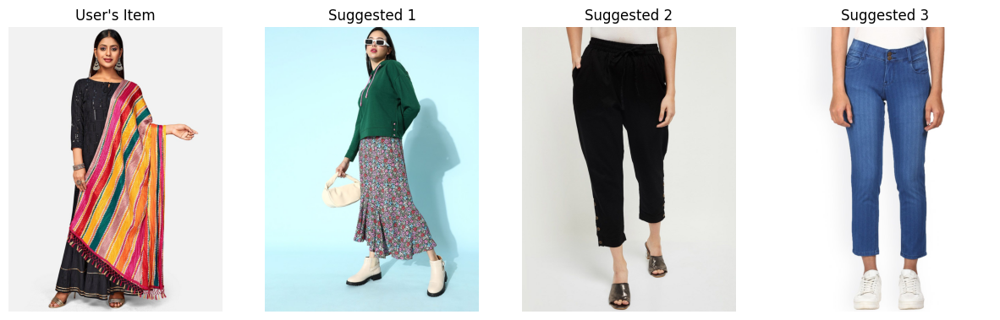


User Item: aurelia women green printed pleated trousers (green)
Matching Outfit Suggestions:
                                                                       name colour      brand  price                                                                                                                                                                                img
                                    dressberry women green solid sweatshirt  green dressberry 1799.0                http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                         nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                                         http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-b6c303a45c7d1619104363004NayoWomenMaroonPrinted1.jpg
anouk beige & red antiviral finish ethnic motifs anti-viral pure c

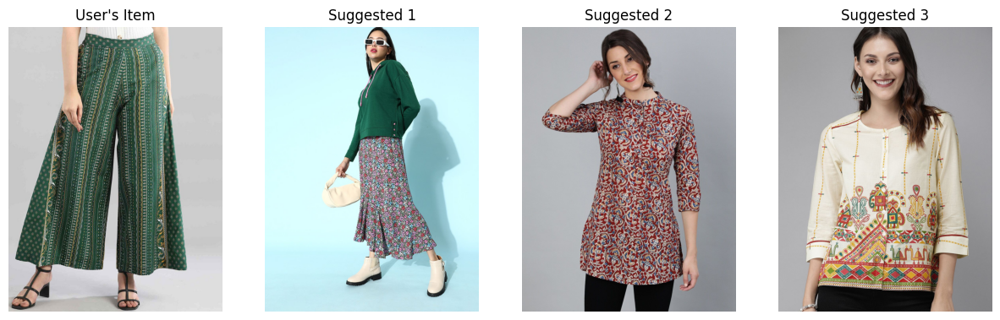


User Item: street 9 women green solid kurta with palazzos (green)
Matching Outfit Suggestions:
                                                                      name colour    brand  price                                                                                                                                                                              img
oxolloxo women multicoloured regular fit abstract printed regular trousers  multi oxolloxo 2499.0                                                         http://assets.myntassets.com/assets/images/productimage/2021/4/5/6b54b340-6c19-45e7-8b25-dd9649c8623f1617615947563-1.jpg
                     mango women purple textured knitted midi pencil skirt purple    mango 2790.0 http://assets.myntassets.com/assets/images/18259234/2022/5/26/d6d75426-4762-4a24-9f45-0add3c551d0e1653544520515MANGOWomenCream-ColouredCasualShirtShirtsMANGOMANMenJumpsuit1.jpg
                              madame women mauve lightweight puffer jacket  mau

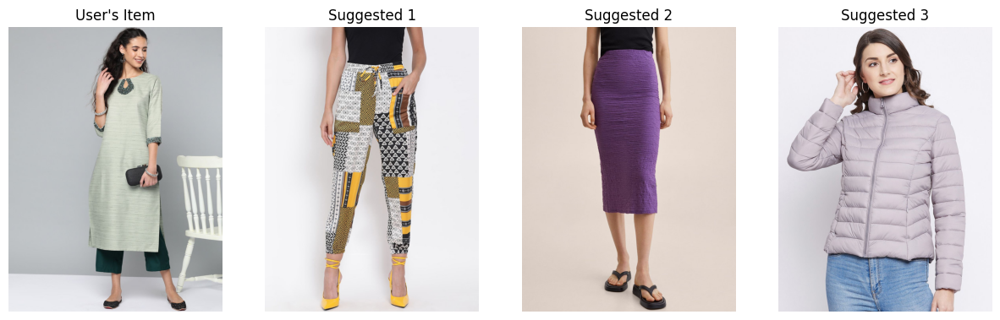


User Item: faballey women green & white printed basic jumpsuit (green)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-45

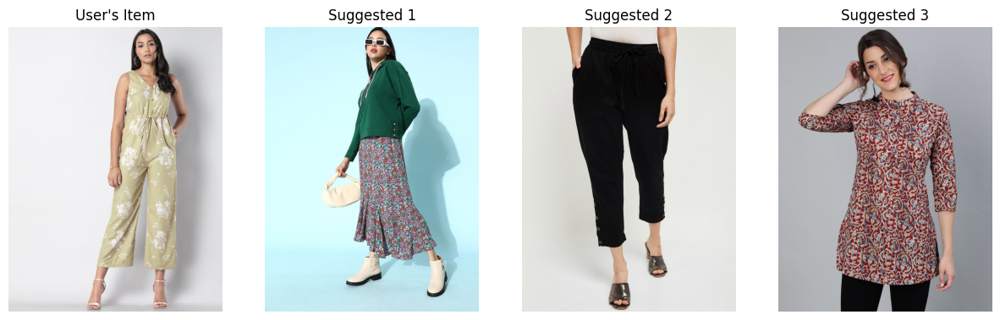


User Item: tokyo talkies women green solid casual-fit a-line skirt (green)
Matching Outfit Suggestions:
                                              name colour      brand  price                                                                                                                                                                 img
           dressberry women green solid sweatshirt  green dressberry 1799.0 http://assets.myntassets.com/assets/images/14219712/2021/11/17/69e883a8-8033-47de-9bd4-345c39ba702a1637142475003-DressBerry-Women-Sweatshirts-491637142474573-1.jpg
                          max women black trousers  black        max  499.0                           http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
nayo women's maroon & cream-coloured printed tunic maroon       nayo 1299.0                          http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1

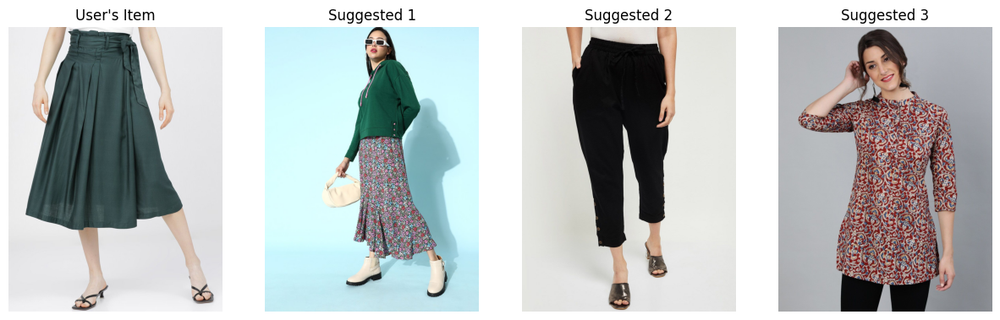

In [ ]:
import pandas as pd
import sqlite3
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import requests
from io import BytesIO
from sklearn.preprocessing import LabelEncoder

# Load the cleaned dataset
df = pd.read_csv('cleaned_file.csv')

# Encode categorical features
df['colour_encoded'] = LabelEncoder().fit_transform(df['colour'].astype(str))
df['category'] = df['name'].apply(lambda x: classify_clothing(x))
df['category_encoded'] = LabelEncoder().fit_transform(df['category'].astype(str))

# Split data into training and testing sets (80% train, 20% test)
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Save training and test sets
train_df.to_csv('train_data.csv', index=False)
test_df.to_csv('test_data.csv', index=False)

# Prepare data for clustering
features = ['price', 'ratingCount', 'avg_rating', 'colour_encoded', 'category_encoded']
train_df = train_df.dropna(subset=features)  # Drop rows with missing values
X = train_df[features].values  # Convert to NumPy array

# Apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)

# Assign cluster labels to outfits
train_df['cluster'] = kmeans.labels_

# Save clustered data
train_df.to_csv('clustered_train_data.csv', index=False)
print("Clustering completed and saved as 'clustered_train_data.csv'.")

# Evaluate clustering using Silhouette Score
silhouette_avg = silhouette_score(X, kmeans.labels_)
print(f"Silhouette Score: {silhouette_avg:.4f}")

# Function to classify clothing items based on their names
def classify_clothing(name):
    name = name.lower()
    if any(word in name for word in ['shirt', 't-shirt', 'top', 'blouse']):
        return 'top'
    elif any(word in name for word in ['jeans', 'trousers', 'pants', 'joggers']):
        return 'bottom'
    elif any(word in name for word in ['skirt', 'shorts']):
        return 'skirt/shorts'
    elif any(word in name for word in ['dress', 'gown', 'jumpsuit']):
        return 'one-piece'
    elif any(word in name for word in ['jacket', 'coat', 'blazer']):
        return 'outerwear'
    elif any(word in name for word in ['sweater', 'hoodie', 'sweatshirt']):
        return 'warm-wear'
    else:
        return 'other'

# Function to generate outfit combinations based on user's clothes and display images from URLs
def generate_combinations(user_color):
    user_clothes = test_df[test_df['colour'].str.lower() == user_color.lower()]
    
    if user_clothes.empty:
        print(f"No outfits found in user's clothes with color {user_color}.")
        return
    
    print(f"Outfit combinations for color: {user_color}")
    count = 0
    for _, item in user_clothes.iterrows():
        if count >= 5:
            break
        cluster_id = kmeans.predict([[item['price'], item['ratingCount'], item['avg_rating'], item['colour_encoded'], item['category_encoded']]])[0]
        similar_items = train_df[train_df['cluster'] == cluster_id]
        
        # Exclude items that are too similar to the user's item
        similar_items = similar_items[similar_items['name'] != item['name']]
        
        # Ensure the suggested items are not of the same category
        similar_items = similar_items[similar_items['category'] != item['category']]
        
        print(f"\nUser Item: {item['name']} ({item['colour']})")
        print("Matching Outfit Suggestions:")
        print(similar_items[['name', 'colour', 'brand', 'price', 'img']].head(3).to_string(index=False))
        
        # Display images
        fig, axes = plt.subplots(1, 4, figsize=(15, 5))
        
        try:
            response = requests.get(item['img'])
            user_image = Image.open(BytesIO(response.content))
            axes[0].imshow(user_image)
            axes[0].set_title("User's Item")
            axes[0].axis("off")
        except:
            print("Could not load user image.")
        
        for idx, (_, outfit) in enumerate(similar_items.head(3).iterrows()):
            try:
                response = requests.get(outfit['img'])
                outfit_image = Image.open(BytesIO(response.content))
                axes[idx + 1].imshow(outfit_image)
                axes[idx + 1].set_title(f"Suggested {idx+1}")
                axes[idx + 1].axis("off")
            except:
                print(f"Could not load image for: {outfit['name']}")
        
        plt.show()
        count += 1

# Example usage
user_input_color = input("Enter a color: ")
generate_combinations(user_input_color)


Clustering completed and saved as 'clustered_train_data.csv'.
Silhouette Score: 0.5458
Outfit combinations for color: red

User Item: tokyo talkies women red solid slim fit trousers (red)
Matching Outfit Suggestions:
                                                                       name colour     brand  price                                                                                                                                                                                img
                         nayo women's maroon & cream-coloured printed tunic maroon      nayo 1299.0                                         http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-b6c303a45c7d1619104363004NayoWomenMaroonPrinted1.jpg
anouk beige & red antiviral finish ethnic motifs anti-viral pure cotton top  beige     anouk 1599.0 http://assets.myntassets.com/assets/images/12135374/2021/1/21/63e91931-35fc-4915-bb58-e2bdc7e2ebc11611230281502-Anouk-Women-B

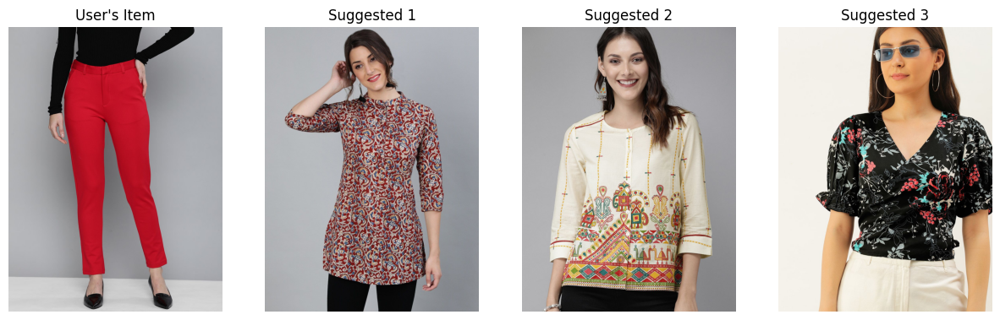


User Item: max red dupatta with tasseled border (red)
Matching Outfit Suggestions:
                                                                       name colour     brand  price                                                                                                                                                                                img
                                                   max women black trousers  black       max  499.0                                          http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
anouk beige & red antiviral finish ethnic motifs anti-viral pure cotton top  beige     anouk 1599.0 http://assets.myntassets.com/assets/images/12135374/2021/1/21/63e91931-35fc-4915-bb58-e2bdc7e2ebc11611230281502-Anouk-Women-Beige--Red-Antiviral-Finish-Ethnic-Printed-Anti--1.jpg
            berrylush black floral printed puff sleeves crepe wrap crop top  bl

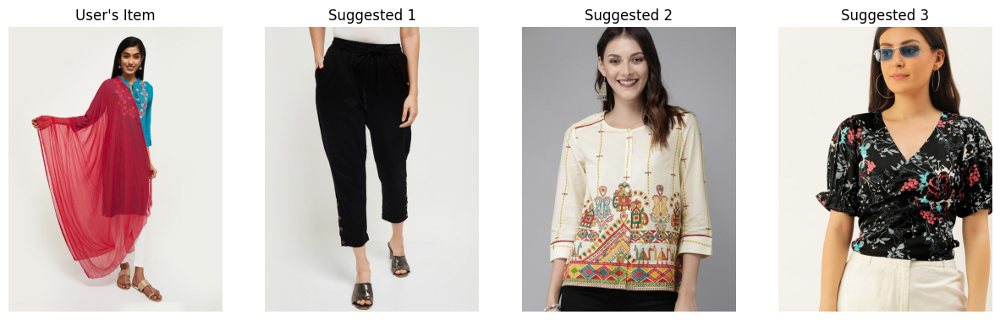


User Item: dupatta bazaar red & white printed bandhani dupatta (red)
Matching Outfit Suggestions:
                                                                       name colour     brand  price                                                                                                                                                                                img
                                                   max women black trousers  black       max  499.0                                          http://assets.myntassets.com/assets/images/15774400/2021/10/8/54dadd41-2150-4791-8438-b9c237102ace1633713578195maxWomenBlackTrousers1.jpg
anouk beige & red antiviral finish ethnic motifs anti-viral pure cotton top  beige     anouk 1599.0 http://assets.myntassets.com/assets/images/12135374/2021/1/21/63e91931-35fc-4915-bb58-e2bdc7e2ebc11611230281502-Anouk-Women-Beige--Red-Antiviral-Finish-Ethnic-Printed-Anti--1.jpg
            berrylush black floral printed puff sleeves crepe wr

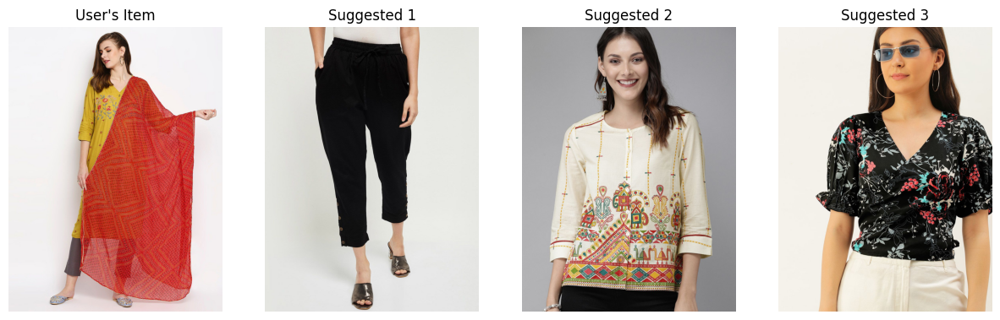


User Item: jaipur kurti plus size women red regular fit solid trousers (red)
Matching Outfit Suggestions:
                                                                       name colour     brand  price                                                                                                                                                                                img
                         nayo women's maroon & cream-coloured printed tunic maroon      nayo 1299.0                                         http://assets.myntassets.com/assets/images/14170550/2021/4/22/43abf33c-ae1f-4586-bc7d-b6c303a45c7d1619104363004NayoWomenMaroonPrinted1.jpg
anouk beige & red antiviral finish ethnic motifs anti-viral pure cotton top  beige     anouk 1599.0 http://assets.myntassets.com/assets/images/12135374/2021/1/21/63e91931-35fc-4915-bb58-e2bdc7e2ebc11611230281502-Anouk-Women-Beige--Red-Antiviral-Finish-Ethnic-Printed-Anti--1.jpg
            berrylush black floral printed puff sleeves 

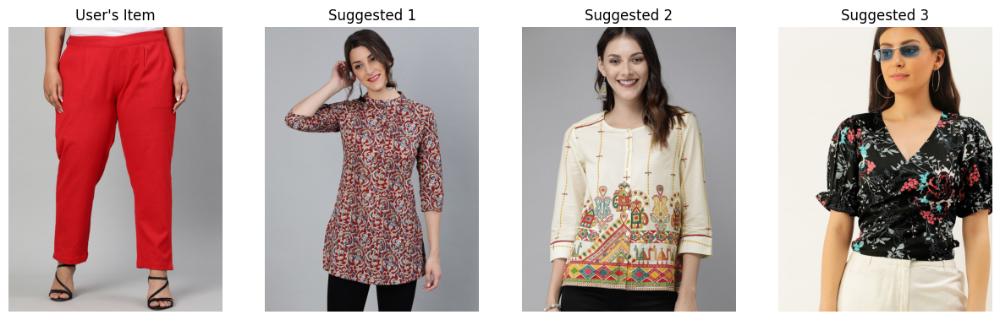


User Item: soch red & gold-toned ethnic motifs sequinned saree (red)
Matching Outfit Suggestions:
                                                                              name colour      brand  price                                                                                                                                                                               img
                                         missguided women black solid parka jacket  black missguided 8540.0                   http://assets.myntassets.com/assets/images/15955222/2021/11/8/24edf1de-262f-4591-9dc2-fd4884637e3f1636363713267-Missguided-Women-Jackets-1901636363713019-1.jpg
indo era women beige floral embroidered regular kurta with trousers & with dupatta  beige   indo era 6999.0 http://assets.myntassets.com/assets/images/15798284/2021/10/12/21c85305-7002-4063-ad64-31c722a0a85f1633978192250IndoEraWomenBrownFloralPrintedPanelledKurtawithTrousersWithD1.jpg
                                   roadster

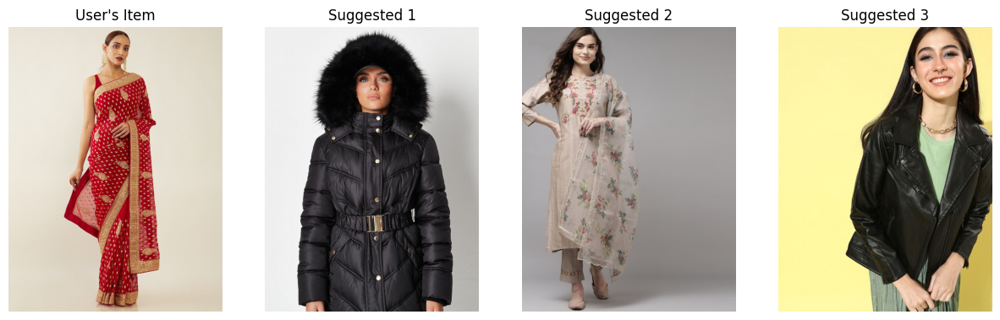

In [18]:
import pandas as pd
import sqlite3
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import numpy as np
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import requests
from io import BytesIO
from sklearn.preprocessing import LabelEncoder

# Load the cleaned dataset
df = pd.read_csv('cleaned_file.csv')

# Define extended color combinations
define_color_combinations = {
    "black": ["white", "grey", "red", "blue", "maroon", "beige"],
    "white": ["black", "blue", "pink", "green", "yellow"],
    "blue": ["white", "black", "grey", "yellow", "navy", "sky blue"],
    "red": ["black", "white", "navy", "beige", "maroon"],
    "grey": ["black", "white", "blue", "maroon", "brown"],
    "green": ["white", "beige", "brown", "navy", "olive"],
    "yellow": ["blue", "black", "white", "grey", "beige"],
}

# Encode categorical features
df['colour_encoded'] = LabelEncoder().fit_transform(df['colour'].astype(str))
df['category'] = df['name'].apply(lambda x: classify_clothing(x))
df['category_encoded'] = LabelEncoder().fit_transform(df['category'].astype(str))

# Split data into training and testing sets (80% train, 20% test)
train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

# Save training and test sets
train_df.to_csv('train_data.csv', index=False)
test_df.to_csv('test_data.csv', index=False)

# Prepare data for clustering
features = ['price', 'ratingCount', 'avg_rating', 'colour_encoded', 'category_encoded']
train_df = train_df.dropna(subset=features)  # Drop rows with missing values
X = train_df[features].values  # Convert to NumPy array

# Apply K-Means Clustering
kmeans = KMeans(n_clusters=5, random_state=42)
kmeans.fit(X)

# Assign cluster labels to outfits
train_df['cluster'] = kmeans.labels_

# Save clustered data
train_df.to_csv('clustered_train_data.csv', index=False)
print("Clustering completed and saved as 'clustered_train_data.csv'.")

# Evaluate clustering using Silhouette Score
silhouette_avg = silhouette_score(X, kmeans.labels_)
print(f"Silhouette Score: {silhouette_avg:.4f}")

# Function to classify clothing items based on their names
def classify_clothing(name):
    name = name.lower()
    if any(word in name for word in ['shirt', 't-shirt', 'top', 'blouse']):
        return 'top'
    elif any(word in name for word in ['jeans', 'trousers', 'pants', 'joggers']):
        return 'bottom'
    elif any(word in name for word in ['skirt', 'shorts']):
        return 'skirt/shorts'
    elif any(word in name for word in ['dress', 'gown', 'jumpsuit']):
        return 'one-piece'
    elif any(word in name for word in ['jacket', 'coat', 'blazer']):
        return 'outerwear'
    elif any(word in name for word in ['sweater', 'hoodie', 'sweatshirt']):
        return 'warm-wear'
    else:
        return 'other'

# Function to generate outfit combinations based on user's clothes and display images from URLs
def generate_combinations(user_color):
    user_clothes = test_df[test_df['colour'].str.lower() == user_color.lower()]
    
    if user_clothes.empty:
        print(f"No outfits found in user's clothes with color {user_color}.")
        return
    
    compatible_colors = define_color_combinations.get(user_color.lower(), [])
    print(f"Outfit combinations for color: {user_color}")
    count = 0
    for _, item in user_clothes.iterrows():
        if count >= 5:
            break
        cluster_id = kmeans.predict([[item['price'], item['ratingCount'], item['avg_rating'], item['colour_encoded'], item['category_encoded']]])[0]
        similar_items = train_df[train_df['cluster'] == cluster_id]
        
        # Filter items that match the defined color combinations
        similar_items = similar_items[similar_items['colour'].str.lower().isin(compatible_colors)]
        
        # Ensure the suggested items are not of the same category
        similar_items = similar_items[similar_items['category'] != item['category']]
        
        print(f"\nUser Item: {item['name']} ({item['colour']})")
        print("Matching Outfit Suggestions:")
        print(similar_items[['name', 'colour', 'brand', 'price', 'img']].head(3).to_string(index=False))
        
        # Display images
        fig, axes = plt.subplots(1, 4, figsize=(15, 5))
        
        try:
            response = requests.get(item['img'])
            user_image = Image.open(BytesIO(response.content))
            axes[0].imshow(user_image)
            axes[0].set_title("User's Item")
            axes[0].axis("off")
        except:
            print("Could not load user image.")
        
        for idx, (_, outfit) in enumerate(similar_items.head(3).iterrows()):
            try:
                response = requests.get(outfit['img'])
                outfit_image = Image.open(BytesIO(response.content))
                axes[idx + 1].imshow(outfit_image)
                axes[idx + 1].set_title(f"Suggested {idx+1}")
                axes[idx + 1].axis("off")
            except:
                print(f"Could not load image for: {outfit['name']}")
        
        plt.show()
        count += 1

# Example usage
user_input_color = input("Enter a color: ")
generate_combinations(user_input_color)
